In [1]:
# --- packages --- #
import numpy as np 
import pandas as pd
import os, sys, glob

import matplotlib.pyplot as plt
import matplotlib.colors as colors


from ctapipe_io_magic import MAGICEventSource
from ctapipe.visualization import CameraDisplay
from ctapipe.io import EventSeeker, EventSource
from ctapipe.instrument import CameraGeometry
import astropy.units as u
import tables

from IPython.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))

# --- path to all scripts --- #
sys.path.insert(0, '/fefs/aswg/workspace/juan.jimenez/stereo_analysis/scripts')
import auxiliar as aux
import geometry as geom
# graphic parameters
aux.params()

# creating a folder to save the plots
pltpath = 'plots/3_events/'
if not os.path.exists(pltpath):
    os.makedirs(pltpath)
dpi = 200

In [2]:
source_name = 'Crab'

path_merged = f'/fefs/aswg/workspace/juan.jimenez/data/dl2/coincident/dl2_merged_{source_name}.h5'
df_merged =  pd.read_hdf(path_merged, key='events/parameters')

path_mean   = f'/fefs/aswg/workspace/juan.jimenez/data/dl2/coincident/dl2_mean_{source_name}.h5'
df_mean   =  pd.read_hdf(path_mean,   key='events/parameters')

df_T1 = df_merged.query('tel_id == 1', inplace=False)
df_T2 = df_merged.query('tel_id == 2', inplace=False)
df_T3 = df_merged.query('tel_id == 3', inplace=False)

In [3]:
# this config done since ev80
# energy    = 3
# gammaness = 0.7 
# intensity = 400
# camera_dist = 0.3
# dist_impact = 100

energy    = 1
gammaness = 0.9
intensity = 9000
camera_dist = 0.3
dist_impact = 100


mask_eg   = f'reco_energy > {energy} and gammaness > {gammaness} '
mask_cent = f'and x > -{camera_dist} and x < {camera_dist} and y > -{camera_dist} and y < {camera_dist}' 
mask_impact = f'and core_x > -{dist_impact} and core_x < {dist_impact} and core_y > -{dist_impact} and core_y< {dist_impact}'


# ############################
# df_mean.reset_index(inplace=True)
# df_mean.query(mask_eg, inplace=True)
# ############################


#######################333
df_T1.query(f'intensity > {intensity} and obs_id != 7198 and gammaness > 0.6', inplace=True)
df_mean.query(f'reco_energy > {energy}',inplace=True)
##########################

total_ids1 = df_T1['total_id']
total_ids2 = df_mean['total_id']
total_ids  =  set(total_ids1) & set(total_ids2)


df_T1.reset_index(inplace=True)
df_T2.reset_index(inplace=True)
df_T3.reset_index(inplace=True)
df_mean.reset_index(inplace=True)



df_T1.query(f'total_id in @total_ids', inplace=True)
df_T2.query(f'total_id in @total_ids', inplace=True)
df_T3.query(f'total_id in @total_ids', inplace=True)
df_mean.query(f'total_id in @total_ids', inplace=True)

# df_evs = df_T1.sort_values('obs_id', inplace=True)

up, do = (230, 300)
df_T1 = df_T1[up:do]
df_T2 = df_T2[up:do]
df_T3 = df_T3[up:do]
df_mean = df_mean[up:do]

(df_T1)

/tmp/ipykernel_17897/1251175096.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_T1.query(f'intensity > {intensity} and obs_id != 7198 and gammaness > 0.6', inplace=True)
/tmp/ipykernel_17897/1251175096.py:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_T1.query(f'total_id in @total_ids', inplace=True)
/tmp/ipykernel_17897/1251175096.py:44: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_T2.query(f'total_id in @total_ids',

,obs_id,event_id,tel_id,obs_id_magic,event_id_magic,obs_id_lst,event_id_lst,intensity,x,y,r,phi,length,length_uncertainty,width,width_uncertainty,psi,skewness,kurtosis,slope,intercept,intensity_width_1,intensity_width_2,pixels_width_1,pixels_width_2,n_pixels,n_islands,pointing_alt,pointing_az,timestamp,time_diff,multiplicity,combo_type,alt,alt_uncert,az,az_uncert,core_x,core_y,impact,h_max,reco_energy,reco_energy_var,reco_disp,reco_disp_var,reco_alt,reco_az,disp_diff_sum,disp_diff_mean,gammaness,gammaness_var,total_id,magic_id,pointing_zd,reco_zd
230,3266,4125125,1,5093712,226581,3266.0,4125125.0,13978.051620,0.001813,0.649809,0.649811,89.840121,0.099914,0.001281,0.035905,0.000531,70.489676,0.178084,3.193771,-1.993667,23.809012,0.000000,0.000000,0.000000,0.000000,46,1,0.818531,1.537244,1.608069e+09,0.000029,3,3,46.658465,0.819485,89.001306,0.819485,-79.589331,104.482056,73.845459,12952.539070,5.642203,0.002245,0.645238,0.010268,46.681754,89.129300,0.462021,0.154007,0.910438,0.081540,3266.4125125,5093712.226581,-89.181469,-43.318246
231,3266,4181111,1,5093712,229013,3266.0,4181111.0,9425.543915,-0.335349,-0.223812,0.403176,-146.280858,0.208672,0.003378,0.046102,0.000865,30.976388,0.623862,3.359023,8.981551,21.840530,0.000000,0.000000,0.000000,0.000000,109,3,0.819239,1.537605,1.608069e+09,0.000160,3,3,45.117236,0.242397,86.489658,0.242397,-127.252741,323.780427,206.986054,10750.706339,5.420376,0.004894,1.449012,0.005588,44.997420,86.396318,0.178001,0.059334,0.762500,0.181094,3266.4181111,5093712.229013,-89.180761,-45.002580
232,3266,4243106,1,5093712,231693,3266.0,4243106.0,10923.211426,0.068016,-0.120165,0.138079,-60.489105,0.096253,0.001295,0.041590,0.000971,73.860141,0.530162,2.890145,-1.238347,19.885757,0.000000,0.000000,0.000000,0.000000,46,1,0.819967,1.537978,1.608069e+09,0.000219,3,3,46.827993,3.232025,86.426350,3.232025,-120.325264,118.504903,114.802907,8430.959638,2.959168,0.010423,0.750639,0.004564,46.902414,86.704354,0.333090,0.111030,0.736071,0.194270,3266.4243106,5093712.231693,-89.180033,-43.097586
233,3266,4258060,1,5093712,232373,3266.0,4258060.0,22415.346523,-0.581196,-0.118662,0.593186,-168.460589,0.107255,0.001085,0.039967,0.000538,18.224094,-0.574832,3.190989,0.820314,21.108922,0.000000,0.000000,0.000000,0.000000,54,1,0.820150,1.538077,1.608069e+09,0.000009,3,3,46.421466,0.038200,88.061809,0.038200,32.809458,-73.709458,116.384519,10434.290896,7.601307,0.006397,0.700590,0.001869,46.467321,88.090891,1.244632,0.414877,0.802000,0.158796,3266.4258060,5093712.232373,-89.179850,-43.532679
234,3266,4284463,1,5093712,233553,3266.0,4284463.0,43710.568542,-0.146254,0.112641,0.184603,142.397418,0.105054,0.000746,0.035925,0.000268,-83.405077,-0.806705,3.107660,5.352699,20.984119,0.000000,0.000000,0.000000,0.000000,43,1,0.820482,1.538248,1.608069e+09,0.000291,3,3,46.783086,9.803244,87.792749,9.803244,-72.963525,65.331375,65.687296,9789.717398,16.056029,0.011054,0.529161,0.005034,46.770859,87.704180,0.388882,0.129627,0.929333,0.065673,3266.4284463,5093712.233553,-89.179518,-43.229141
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
295,3267,2727087,1,5093713,138869,3267.0,2727087.0,17605.175274,-0.850689,0.514809,0.994334,148.819053,0.088654,0.000930,0.048432,0.000826,34.477194,-0.209237,2.851628,-5.338716,23.844405,0.260532,0.559319,0.005391,0.010782,47,3,0.854942,1.543430,1.608070e+09,0.000021,3,3,47.487979,1.192730,90.199118,1.192730,31.220930,-16.407048,79.899599,8318.175730,5.024562,0.010701,0.594337,0.022179,47.714871,90.497674,1.950344,0.650115,0.725833,0.198999,3267.2727087,5093713.138869,-89.145058,-42.285129
296,3267,2731518,1,5093713,139047,3267.0,2731518.0,10378.879990,-0.789236,-0.334902,0.857352,-157.006685,0.120668,0.001510,0.044429,0.000663,-16.373403,-0.481980,2.551983,-4.545094,20.743156,0.031197,0.081612,0.003235,0.007008,57,1,0.8549

In [4]:
run_m      = df_T1['obs_id_magic'].to_numpy()
run_l      = df_T1['obs_id'].to_numpy()
event_id_m = df_T1['event_id_magic'].to_numpy()
event_id_l = df_T1['event_id'].to_numpy()

energ  = df_mean['reco_energy'].to_numpy()
gamma  = df_mean['gammaness'].to_numpy()

corex      = [df['x'].to_numpy()               for df in [df_T1, df_T2, df_T3]]
corey      = [df['y'].to_numpy()               for df in [df_T1, df_T2, df_T3]]
width  = [df['width'].to_numpy()           for df in [df_T1, df_T2, df_T3]]
length = [df['length'].to_numpy()          for df in [df_T1, df_T2, df_T3]]
angle  = [np.deg2rad(df['psi'].to_numpy()) for df in [df_T1, df_T2, df_T3]]

In [5]:
def find_firstev_srun_magic(files):
    events_srun = []
    for i, srun in enumerate(files):
        event_source = MAGICEventSource(input_url=srun, process_run=False, max_events=1)
        seeker       = EventSeeker(event_source=event_source)
        event        = seeker.get_event_index(0)
        events_srun.append(event.index.event_id)    
    return events_srun

def find_subrun(ev_id, events_srun):
    srun_index = None
    for i in range(len(events_srun)-1):
        if ev_id >= events_srun[i] and ev_id < events_srun[i+1]:
            srun_index = i
    if srun_index == None:
        if ev_id > events_srun[-1]:
            srun_index = range(len(events_srun))[-1]
    return srun_index

## Finding the correspondent subruns

In [6]:
%%time

abs_run_m = sorted(np.unique(run_m))

abs_files_m1, abs_files_m2 = [], []
for i, run in enumerate(abs_run_m):
    abs_files_m1.append(sorted(glob.glob(f'/fefs/onsite/common/MAGIC/data/M1/event/Calibrated/*/*/*/*{run}.*_Y_*.root')))
    abs_files_m2.append(sorted(glob.glob(f'/fefs/onsite/common/MAGIC/data/M2/event/Calibrated/*/*/*/*{run}.*_Y_*.root')))
    
files_m1, files_m2 = [], []    
for i, run in enumerate(run_m):
    files_m1.append(sorted(glob.glob(f'/fefs/onsite/common/MAGIC/data/M1/event/Calibrated/*/*/*/*{run}.*_Y_*.root')))
    files_m2.append(sorted(glob.glob(f'/fefs/onsite/common/MAGIC/data/M2/event/Calibrated/*/*/*/*{run}.*_Y_*.root'))) 
    
events_srun_m1, events_srun_m2 = [], [] 
for i, run in enumerate(abs_run_m):
    print(f'Reading... {i} of {len(abs_run_m)} --> {i/len(abs_run_m)*100:.1f}%')
    events_srun_m1.append(find_firstev_srun_magic(abs_files_m1[i]))
    events_srun_m2.append(find_firstev_srun_magic(abs_files_m2[i]))
    
srun_m1, srun_m2 = [], []    
for i, ev in enumerate(event_id_m): 
    
    index = np.where(abs_run_m == run_m[i])[0][0]
    events_srun1 = events_srun_m1[index]
    events_srun2 = events_srun_m2[index]
    
    srun_m1.append(find_subrun(event_id_m[i], events_srun1))
    srun_m2.append(find_subrun(event_id_m[i], events_srun2))
    
srun_l = event_id_l//53000

Reading... 0 of 2 --> 0.0%


Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:43:03.706 to 2020-12-15 21:57:33.667.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:43:03.706 to 2020-12-15 21:57:33.667.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:43:03.706 to 2020-12-15 21:57:33.667.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:43:03.706 to 2020-12-15 21:57:33.667.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
D

Reading... 1 of 2 --> 50.0%


Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 114 drive reports.
Drive reports available from 2020-12-15 21:58:13.325 to 2020-12-15 22:12:57.629.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 114 drive reports.
Drive reports available from 2020-12-15 21:58:13.325 to 2020-12-15 22:12:57.629.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 114 drive reports.
Drive reports available from 2020-12-15 21:58:13.325 to 2020-12-15 22:12:57.629.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 114 drive reports.
Drive reports available from 2020-12-15 21:58:13.325 to 2020-12-15 22:12:57.629.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 114 drive reports.
D

Drive reports available from 2020-12-15 21:58:13.411 to 2020-12-15 22:12:58.493.
File /fefs/onsite/common/MAGIC/data/M2/event/Calibrated/2020/12/16/20201216_M2_05093713.001_Y_CrabNebula-W0.40+035.root has only 1 drive reports.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:58:13.411 to 2020-12-15 22:12:58.493.


CPU times: user 2min 43s, sys: 18.4 s, total: 3min 1s
Wall time: 3min 32s


## Finding filenames

In [7]:
file_m1 = np.array([files_m1[i][srun_m1[i]] for i in range(len(files_m1))])
file_m2 = np.array([files_m2[i][srun_m2[i]] for i in range(len(files_m2))])

file_l = [glob.glob(f'/fefs/aswg/data/real/DL1/*/*/tailcut84/dl1*{run:05.0f}.{srun_l[i]:04.0f}.h5')[0] for i, run in enumerate(run_l)]

## Extracting LST images

In [8]:
%%time

image_l = []
for i in range(len(file_l)):

    try:
        table = tables.open_file(file_l[i])
        event_index = np.where(table.root.dl1.event.telescope.image.LST_LSTCam.col('event_id')==event_id_l[i])[0][0]
        image_l.append(table.root.dl1.event.telescope.image.LST_LSTCam.col('image')[event_index])
        
    except:
        fl = file_l[i].replace(f'{srun_l[i]:04.0f}', f'{srun_l[i]-1:04.0f}')
        
        table = tables.open_file(fl)
        event_index = np.where(table.root.dl1.event.telescope.image.LST_LSTCam.col('event_id')==event_id_l[i])[0][0]
        image_l.append(table.root.dl1.event.telescope.image.LST_LSTCam.col('image')[event_index])

CPU times: user 2min 15s, sys: 39.5 s, total: 2min 54s
Wall time: 3min 11s


## Extracting MAGIC images

In [9]:
%%time

image_m1, image_m2 = [], []

for i in range(len(file_m1)):
    
    print(f'{i} of {len(file_m1)} -{run_m[i]}-{event_id_m[i]}\n-->{file_m1[i]}')
    
    event_source1 = MAGICEventSource(input_url=file_m1[i], process_run=False,)
    event_source2 = MAGICEventSource(input_url=file_m2[i], process_run=False,)

    seeker1 = EventSeeker(event_source=event_source1)
    seeker2 = EventSeeker(event_source=event_source2)

    event1 = seeker1.get_event_id(event_id_m[i])
    event2 = seeker2.get_event_id(event_id_m[i])
    
    image_m1.append(event1.dl1.tel[1].image)
    image_m2.append(event2.dl1.tel[2].image)
    

0 of 70 -5093712-226581
-->/fefs/onsite/common/MAGIC/data/M1/event/Calibrated/2020/12/16/20201216_M1_05093712.014_Y_CrabNebula-W0.40+215.root


Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:43:03.706 to 2020-12-15 21:57:33.667.
Seeking event by iterating through events.. (potentially long process)
Jump of L3 number backward from 236542 to 236541; total jumped number so far: 1
Interpolating cosmic events information from 114 drive reports.
Drive reports available from 2020-12-15 21:43:03.533 to 2020-12-15 21:57:34.186.


1 of 70 -5093712-229013
-->/fefs/onsite/common/MAGIC/data/M1/event/Calibrated/2020/12/16/20201216_M1_05093712.014_Y_CrabNebula-W0.40+215.root


Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:43:03.706 to 2020-12-15 21:57:33.667.
Seeking event by iterating through events.. (potentially long process)
Jump of L3 number backward from 236542 to 236541; total jumped number so far: 1
Interpolating cosmic events information from 114 drive reports.
Drive reports available from 2020-12-15 21:43:03.533 to 2020-12-15 21:57:34.186.


2 of 70 -5093712-231693
-->/fefs/onsite/common/MAGIC/data/M1/event/Calibrated/2020/12/16/20201216_M1_05093712.014_Y_CrabNebula-W0.40+215.root


Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:43:03.706 to 2020-12-15 21:57:33.667.
Seeking event by iterating through events.. (potentially long process)
Jump of L3 number backward from 236542 to 236541; total jumped number so far: 1
Interpolating cosmic events information from 114 drive reports.
Drive reports available from 2020-12-15 21:43:03.533 to 2020-12-15 21:57:34.186.


3 of 70 -5093712-232373
-->/fefs/onsite/common/MAGIC/data/M1/event/Calibrated/2020/12/16/20201216_M1_05093712.014_Y_CrabNebula-W0.40+215.root


Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:43:03.706 to 2020-12-15 21:57:33.667.
Seeking event by iterating through events.. (potentially long process)
Jump of L3 number backward from 236542 to 236541; total jumped number so far: 1
Interpolating cosmic events information from 114 drive reports.
Drive reports available from 2020-12-15 21:43:03.533 to 2020-12-15 21:57:34.186.


4 of 70 -5093712-233553
-->/fefs/onsite/common/MAGIC/data/M1/event/Calibrated/2020/12/16/20201216_M1_05093712.014_Y_CrabNebula-W0.40+215.root


Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:43:03.706 to 2020-12-15 21:57:33.667.
Seeking event by iterating through events.. (potentially long process)
Jump of L3 number backward from 236542 to 236541; total jumped number so far: 1
Interpolating cosmic events information from 114 drive reports.
Drive reports available from 2020-12-15 21:43:03.533 to 2020-12-15 21:57:34.186.


5 of 70 -5093712-234496
-->/fefs/onsite/common/MAGIC/data/M1/event/Calibrated/2020/12/16/20201216_M1_05093712.014_Y_CrabNebula-W0.40+215.root


Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:43:03.706 to 2020-12-15 21:57:33.667.
Seeking event by iterating through events.. (potentially long process)
Jump of L3 number backward from 236542 to 236541; total jumped number so far: 1
Interpolating cosmic events information from 114 drive reports.
Drive reports available from 2020-12-15 21:43:03.533 to 2020-12-15 21:57:34.186.


6 of 70 -5093712-235355
-->/fefs/onsite/common/MAGIC/data/M1/event/Calibrated/2020/12/16/20201216_M1_05093712.014_Y_CrabNebula-W0.40+215.root


Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:43:03.706 to 2020-12-15 21:57:33.667.
Seeking event by iterating through events.. (potentially long process)
Jump of L3 number backward from 236542 to 236541; total jumped number so far: 1
Interpolating cosmic events information from 114 drive reports.
Drive reports available from 2020-12-15 21:43:03.533 to 2020-12-15 21:57:34.186.


7 of 70 -5093712-235554
-->/fefs/onsite/common/MAGIC/data/M1/event/Calibrated/2020/12/16/20201216_M1_05093712.014_Y_CrabNebula-W0.40+215.root


Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:43:03.706 to 2020-12-15 21:57:33.667.
Seeking event by iterating through events.. (potentially long process)
Jump of L3 number backward from 236542 to 236541; total jumped number so far: 1
Interpolating cosmic events information from 114 drive reports.
Drive reports available from 2020-12-15 21:43:03.533 to 2020-12-15 21:57:34.186.


8 of 70 -5093712-236949
-->/fefs/onsite/common/MAGIC/data/M1/event/Calibrated/2020/12/16/20201216_M1_05093712.014_Y_CrabNebula-W0.40+215.root


Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:43:03.706 to 2020-12-15 21:57:33.667.
Seeking event by iterating through events.. (potentially long process)
Jump of L3 number backward from 236542 to 236541; total jumped number so far: 1
Interpolating cosmic events information from 114 drive reports.
Drive reports available from 2020-12-15 21:43:03.533 to 2020-12-15 21:57:34.186.


9 of 70 -5093713-19447
-->/fefs/onsite/common/MAGIC/data/M1/event/Calibrated/2020/12/16/20201216_M1_05093713.002_Y_CrabNebula-W0.40+035.root


File /fefs/onsite/common/MAGIC/data/M2/event/Calibrated/2020/12/16/20201216_M2_05093713.001_Y_CrabNebula-W0.40+035.root has only 1 drive reports.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 114 drive reports.
Drive reports available from 2020-12-15 21:58:13.325 to 2020-12-15 22:12:57.629.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:58:13.411 to 2020-12-15 22:12:58.493.


10 of 70 -5093713-27921
-->/fefs/onsite/common/MAGIC/data/M1/event/Calibrated/2020/12/16/20201216_M1_05093713.002_Y_CrabNebula-W0.40+035.root


File /fefs/onsite/common/MAGIC/data/M2/event/Calibrated/2020/12/16/20201216_M2_05093713.001_Y_CrabNebula-W0.40+035.root has only 1 drive reports.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 114 drive reports.
Drive reports available from 2020-12-15 21:58:13.325 to 2020-12-15 22:12:57.629.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:58:13.411 to 2020-12-15 22:12:58.493.


11 of 70 -5093713-29192
-->/fefs/onsite/common/MAGIC/data/M1/event/Calibrated/2020/12/16/20201216_M1_05093713.002_Y_CrabNebula-W0.40+035.root


File /fefs/onsite/common/MAGIC/data/M2/event/Calibrated/2020/12/16/20201216_M2_05093713.001_Y_CrabNebula-W0.40+035.root has only 1 drive reports.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 114 drive reports.
Drive reports available from 2020-12-15 21:58:13.325 to 2020-12-15 22:12:57.629.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:58:13.411 to 2020-12-15 22:12:58.493.


12 of 70 -5093713-29292
-->/fefs/onsite/common/MAGIC/data/M1/event/Calibrated/2020/12/16/20201216_M1_05093713.002_Y_CrabNebula-W0.40+035.root


File /fefs/onsite/common/MAGIC/data/M2/event/Calibrated/2020/12/16/20201216_M2_05093713.001_Y_CrabNebula-W0.40+035.root has only 1 drive reports.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 114 drive reports.
Drive reports available from 2020-12-15 21:58:13.325 to 2020-12-15 22:12:57.629.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:58:13.411 to 2020-12-15 22:12:58.493.


13 of 70 -5093713-31197
-->/fefs/onsite/common/MAGIC/data/M1/event/Calibrated/2020/12/16/20201216_M1_05093713.003_Y_CrabNebula-W0.40+035.root


File /fefs/onsite/common/MAGIC/data/M2/event/Calibrated/2020/12/16/20201216_M2_05093713.001_Y_CrabNebula-W0.40+035.root has only 1 drive reports.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 114 drive reports.
Drive reports available from 2020-12-15 21:58:13.325 to 2020-12-15 22:12:57.629.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:58:13.411 to 2020-12-15 22:12:58.493.


14 of 70 -5093713-32224
-->/fefs/onsite/common/MAGIC/data/M1/event/Calibrated/2020/12/16/20201216_M1_05093713.003_Y_CrabNebula-W0.40+035.root


File /fefs/onsite/common/MAGIC/data/M2/event/Calibrated/2020/12/16/20201216_M2_05093713.001_Y_CrabNebula-W0.40+035.root has only 1 drive reports.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 114 drive reports.
Drive reports available from 2020-12-15 21:58:13.325 to 2020-12-15 22:12:57.629.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:58:13.411 to 2020-12-15 22:12:58.493.


15 of 70 -5093713-33830
-->/fefs/onsite/common/MAGIC/data/M1/event/Calibrated/2020/12/16/20201216_M1_05093713.003_Y_CrabNebula-W0.40+035.root


File /fefs/onsite/common/MAGIC/data/M2/event/Calibrated/2020/12/16/20201216_M2_05093713.001_Y_CrabNebula-W0.40+035.root has only 1 drive reports.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 114 drive reports.
Drive reports available from 2020-12-15 21:58:13.325 to 2020-12-15 22:12:57.629.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:58:13.411 to 2020-12-15 22:12:58.493.


16 of 70 -5093713-34973
-->/fefs/onsite/common/MAGIC/data/M1/event/Calibrated/2020/12/16/20201216_M1_05093713.003_Y_CrabNebula-W0.40+035.root


File /fefs/onsite/common/MAGIC/data/M2/event/Calibrated/2020/12/16/20201216_M2_05093713.001_Y_CrabNebula-W0.40+035.root has only 1 drive reports.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 114 drive reports.
Drive reports available from 2020-12-15 21:58:13.325 to 2020-12-15 22:12:57.629.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:58:13.411 to 2020-12-15 22:12:58.493.


17 of 70 -5093713-39245
-->/fefs/onsite/common/MAGIC/data/M1/event/Calibrated/2020/12/16/20201216_M1_05093713.003_Y_CrabNebula-W0.40+035.root


File /fefs/onsite/common/MAGIC/data/M2/event/Calibrated/2020/12/16/20201216_M2_05093713.001_Y_CrabNebula-W0.40+035.root has only 1 drive reports.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 114 drive reports.
Drive reports available from 2020-12-15 21:58:13.325 to 2020-12-15 22:12:57.629.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:58:13.411 to 2020-12-15 22:12:58.493.


18 of 70 -5093713-39269
-->/fefs/onsite/common/MAGIC/data/M1/event/Calibrated/2020/12/16/20201216_M1_05093713.003_Y_CrabNebula-W0.40+035.root


File /fefs/onsite/common/MAGIC/data/M2/event/Calibrated/2020/12/16/20201216_M2_05093713.001_Y_CrabNebula-W0.40+035.root has only 1 drive reports.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 114 drive reports.
Drive reports available from 2020-12-15 21:58:13.325 to 2020-12-15 22:12:57.629.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:58:13.411 to 2020-12-15 22:12:58.493.


19 of 70 -5093713-40192
-->/fefs/onsite/common/MAGIC/data/M1/event/Calibrated/2020/12/16/20201216_M1_05093713.003_Y_CrabNebula-W0.40+035.root


File /fefs/onsite/common/MAGIC/data/M2/event/Calibrated/2020/12/16/20201216_M2_05093713.001_Y_CrabNebula-W0.40+035.root has only 1 drive reports.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 114 drive reports.
Drive reports available from 2020-12-15 21:58:13.325 to 2020-12-15 22:12:57.629.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:58:13.411 to 2020-12-15 22:12:58.493.


20 of 70 -5093713-42720
-->/fefs/onsite/common/MAGIC/data/M1/event/Calibrated/2020/12/16/20201216_M1_05093713.003_Y_CrabNebula-W0.40+035.root


File /fefs/onsite/common/MAGIC/data/M2/event/Calibrated/2020/12/16/20201216_M2_05093713.001_Y_CrabNebula-W0.40+035.root has only 1 drive reports.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 114 drive reports.
Drive reports available from 2020-12-15 21:58:13.325 to 2020-12-15 22:12:57.629.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:58:13.411 to 2020-12-15 22:12:58.493.


21 of 70 -5093713-47091
-->/fefs/onsite/common/MAGIC/data/M1/event/Calibrated/2020/12/16/20201216_M1_05093713.004_Y_CrabNebula-W0.40+035.root


File /fefs/onsite/common/MAGIC/data/M2/event/Calibrated/2020/12/16/20201216_M2_05093713.001_Y_CrabNebula-W0.40+035.root has only 1 drive reports.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 114 drive reports.
Drive reports available from 2020-12-15 21:58:13.325 to 2020-12-15 22:12:57.629.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:58:13.411 to 2020-12-15 22:12:58.493.


22 of 70 -5093713-48669
-->/fefs/onsite/common/MAGIC/data/M1/event/Calibrated/2020/12/16/20201216_M1_05093713.004_Y_CrabNebula-W0.40+035.root


File /fefs/onsite/common/MAGIC/data/M2/event/Calibrated/2020/12/16/20201216_M2_05093713.001_Y_CrabNebula-W0.40+035.root has only 1 drive reports.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 114 drive reports.
Drive reports available from 2020-12-15 21:58:13.325 to 2020-12-15 22:12:57.629.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:58:13.411 to 2020-12-15 22:12:58.493.


23 of 70 -5093713-54064
-->/fefs/onsite/common/MAGIC/data/M1/event/Calibrated/2020/12/16/20201216_M1_05093713.004_Y_CrabNebula-W0.40+035.root


File /fefs/onsite/common/MAGIC/data/M2/event/Calibrated/2020/12/16/20201216_M2_05093713.001_Y_CrabNebula-W0.40+035.root has only 1 drive reports.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 114 drive reports.
Drive reports available from 2020-12-15 21:58:13.325 to 2020-12-15 22:12:57.629.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:58:13.411 to 2020-12-15 22:12:58.493.


24 of 70 -5093713-58124
-->/fefs/onsite/common/MAGIC/data/M1/event/Calibrated/2020/12/16/20201216_M1_05093713.004_Y_CrabNebula-W0.40+035.root


File /fefs/onsite/common/MAGIC/data/M2/event/Calibrated/2020/12/16/20201216_M2_05093713.001_Y_CrabNebula-W0.40+035.root has only 1 drive reports.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 114 drive reports.
Drive reports available from 2020-12-15 21:58:13.325 to 2020-12-15 22:12:57.629.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:58:13.411 to 2020-12-15 22:12:58.493.


25 of 70 -5093713-61305
-->/fefs/onsite/common/MAGIC/data/M1/event/Calibrated/2020/12/16/20201216_M1_05093713.005_Y_CrabNebula-W0.40+035.root


File /fefs/onsite/common/MAGIC/data/M2/event/Calibrated/2020/12/16/20201216_M2_05093713.001_Y_CrabNebula-W0.40+035.root has only 1 drive reports.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 114 drive reports.
Drive reports available from 2020-12-15 21:58:13.325 to 2020-12-15 22:12:57.629.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:58:13.411 to 2020-12-15 22:12:58.493.


26 of 70 -5093713-65705
-->/fefs/onsite/common/MAGIC/data/M1/event/Calibrated/2020/12/16/20201216_M1_05093713.005_Y_CrabNebula-W0.40+035.root


File /fefs/onsite/common/MAGIC/data/M2/event/Calibrated/2020/12/16/20201216_M2_05093713.001_Y_CrabNebula-W0.40+035.root has only 1 drive reports.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 114 drive reports.
Drive reports available from 2020-12-15 21:58:13.325 to 2020-12-15 22:12:57.629.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:58:13.411 to 2020-12-15 22:12:58.493.


27 of 70 -5093713-66649
-->/fefs/onsite/common/MAGIC/data/M1/event/Calibrated/2020/12/16/20201216_M1_05093713.005_Y_CrabNebula-W0.40+035.root


File /fefs/onsite/common/MAGIC/data/M2/event/Calibrated/2020/12/16/20201216_M2_05093713.001_Y_CrabNebula-W0.40+035.root has only 1 drive reports.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 114 drive reports.
Drive reports available from 2020-12-15 21:58:13.325 to 2020-12-15 22:12:57.629.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:58:13.411 to 2020-12-15 22:12:58.493.


28 of 70 -5093713-70791
-->/fefs/onsite/common/MAGIC/data/M1/event/Calibrated/2020/12/16/20201216_M1_05093713.005_Y_CrabNebula-W0.40+035.root


File /fefs/onsite/common/MAGIC/data/M2/event/Calibrated/2020/12/16/20201216_M2_05093713.001_Y_CrabNebula-W0.40+035.root has only 1 drive reports.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 114 drive reports.
Drive reports available from 2020-12-15 21:58:13.325 to 2020-12-15 22:12:57.629.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:58:13.411 to 2020-12-15 22:12:58.493.


29 of 70 -5093713-76050
-->/fefs/onsite/common/MAGIC/data/M1/event/Calibrated/2020/12/16/20201216_M1_05093713.006_Y_CrabNebula-W0.40+035.root


File /fefs/onsite/common/MAGIC/data/M2/event/Calibrated/2020/12/16/20201216_M2_05093713.001_Y_CrabNebula-W0.40+035.root has only 1 drive reports.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 114 drive reports.
Drive reports available from 2020-12-15 21:58:13.325 to 2020-12-15 22:12:57.629.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:58:13.411 to 2020-12-15 22:12:58.493.


30 of 70 -5093713-85579
-->/fefs/onsite/common/MAGIC/data/M1/event/Calibrated/2020/12/16/20201216_M1_05093713.006_Y_CrabNebula-W0.40+035.root


File /fefs/onsite/common/MAGIC/data/M2/event/Calibrated/2020/12/16/20201216_M2_05093713.001_Y_CrabNebula-W0.40+035.root has only 1 drive reports.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 114 drive reports.
Drive reports available from 2020-12-15 21:58:13.325 to 2020-12-15 22:12:57.629.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:58:13.411 to 2020-12-15 22:12:58.493.


31 of 70 -5093713-86634
-->/fefs/onsite/common/MAGIC/data/M1/event/Calibrated/2020/12/16/20201216_M1_05093713.007_Y_CrabNebula-W0.40+035.root


File /fefs/onsite/common/MAGIC/data/M2/event/Calibrated/2020/12/16/20201216_M2_05093713.001_Y_CrabNebula-W0.40+035.root has only 1 drive reports.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 114 drive reports.
Drive reports available from 2020-12-15 21:58:13.325 to 2020-12-15 22:12:57.629.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:58:13.411 to 2020-12-15 22:12:58.493.


32 of 70 -5093713-87847
-->/fefs/onsite/common/MAGIC/data/M1/event/Calibrated/2020/12/16/20201216_M1_05093713.007_Y_CrabNebula-W0.40+035.root


File /fefs/onsite/common/MAGIC/data/M2/event/Calibrated/2020/12/16/20201216_M2_05093713.001_Y_CrabNebula-W0.40+035.root has only 1 drive reports.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 114 drive reports.
Drive reports available from 2020-12-15 21:58:13.325 to 2020-12-15 22:12:57.629.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:58:13.411 to 2020-12-15 22:12:58.493.


33 of 70 -5093713-92134
-->/fefs/onsite/common/MAGIC/data/M1/event/Calibrated/2020/12/16/20201216_M1_05093713.007_Y_CrabNebula-W0.40+035.root


File /fefs/onsite/common/MAGIC/data/M2/event/Calibrated/2020/12/16/20201216_M2_05093713.001_Y_CrabNebula-W0.40+035.root has only 1 drive reports.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 114 drive reports.
Drive reports available from 2020-12-15 21:58:13.325 to 2020-12-15 22:12:57.629.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:58:13.411 to 2020-12-15 22:12:58.493.


34 of 70 -5093713-94686
-->/fefs/onsite/common/MAGIC/data/M1/event/Calibrated/2020/12/16/20201216_M1_05093713.007_Y_CrabNebula-W0.40+035.root


File /fefs/onsite/common/MAGIC/data/M2/event/Calibrated/2020/12/16/20201216_M2_05093713.001_Y_CrabNebula-W0.40+035.root has only 1 drive reports.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 114 drive reports.
Drive reports available from 2020-12-15 21:58:13.325 to 2020-12-15 22:12:57.629.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:58:13.411 to 2020-12-15 22:12:58.493.


35 of 70 -5093713-95513
-->/fefs/onsite/common/MAGIC/data/M1/event/Calibrated/2020/12/16/20201216_M1_05093713.007_Y_CrabNebula-W0.40+035.root


File /fefs/onsite/common/MAGIC/data/M2/event/Calibrated/2020/12/16/20201216_M2_05093713.001_Y_CrabNebula-W0.40+035.root has only 1 drive reports.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 114 drive reports.
Drive reports available from 2020-12-15 21:58:13.325 to 2020-12-15 22:12:57.629.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:58:13.411 to 2020-12-15 22:12:58.493.


36 of 70 -5093713-96504
-->/fefs/onsite/common/MAGIC/data/M1/event/Calibrated/2020/12/16/20201216_M1_05093713.007_Y_CrabNebula-W0.40+035.root


File /fefs/onsite/common/MAGIC/data/M2/event/Calibrated/2020/12/16/20201216_M2_05093713.001_Y_CrabNebula-W0.40+035.root has only 1 drive reports.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 114 drive reports.
Drive reports available from 2020-12-15 21:58:13.325 to 2020-12-15 22:12:57.629.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:58:13.411 to 2020-12-15 22:12:58.493.


37 of 70 -5093713-106774
-->/fefs/onsite/common/MAGIC/data/M1/event/Calibrated/2020/12/16/20201216_M1_05093713.008_Y_CrabNebula-W0.40+035.root


File /fefs/onsite/common/MAGIC/data/M2/event/Calibrated/2020/12/16/20201216_M2_05093713.001_Y_CrabNebula-W0.40+035.root has only 1 drive reports.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 114 drive reports.
Drive reports available from 2020-12-15 21:58:13.325 to 2020-12-15 22:12:57.629.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:58:13.411 to 2020-12-15 22:12:58.493.


38 of 70 -5093713-107153
-->/fefs/onsite/common/MAGIC/data/M1/event/Calibrated/2020/12/16/20201216_M1_05093713.008_Y_CrabNebula-W0.40+035.root


File /fefs/onsite/common/MAGIC/data/M2/event/Calibrated/2020/12/16/20201216_M2_05093713.001_Y_CrabNebula-W0.40+035.root has only 1 drive reports.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 114 drive reports.
Drive reports available from 2020-12-15 21:58:13.325 to 2020-12-15 22:12:57.629.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:58:13.411 to 2020-12-15 22:12:58.493.


39 of 70 -5093713-111525
-->/fefs/onsite/common/MAGIC/data/M1/event/Calibrated/2020/12/16/20201216_M1_05093713.008_Y_CrabNebula-W0.40+035.root


File /fefs/onsite/common/MAGIC/data/M2/event/Calibrated/2020/12/16/20201216_M2_05093713.001_Y_CrabNebula-W0.40+035.root has only 1 drive reports.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 114 drive reports.
Drive reports available from 2020-12-15 21:58:13.325 to 2020-12-15 22:12:57.629.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:58:13.411 to 2020-12-15 22:12:58.493.


40 of 70 -5093713-112076
-->/fefs/onsite/common/MAGIC/data/M1/event/Calibrated/2020/12/16/20201216_M1_05093713.008_Y_CrabNebula-W0.40+035.root


File /fefs/onsite/common/MAGIC/data/M2/event/Calibrated/2020/12/16/20201216_M2_05093713.001_Y_CrabNebula-W0.40+035.root has only 1 drive reports.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 114 drive reports.
Drive reports available from 2020-12-15 21:58:13.325 to 2020-12-15 22:12:57.629.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:58:13.411 to 2020-12-15 22:12:58.493.


41 of 70 -5093713-113520
-->/fefs/onsite/common/MAGIC/data/M1/event/Calibrated/2020/12/16/20201216_M1_05093713.008_Y_CrabNebula-W0.40+035.root


File /fefs/onsite/common/MAGIC/data/M2/event/Calibrated/2020/12/16/20201216_M2_05093713.001_Y_CrabNebula-W0.40+035.root has only 1 drive reports.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 114 drive reports.
Drive reports available from 2020-12-15 21:58:13.325 to 2020-12-15 22:12:57.629.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:58:13.411 to 2020-12-15 22:12:58.493.


42 of 70 -5093713-115299
-->/fefs/onsite/common/MAGIC/data/M1/event/Calibrated/2020/12/16/20201216_M1_05093713.009_Y_CrabNebula-W0.40+035.root


File /fefs/onsite/common/MAGIC/data/M2/event/Calibrated/2020/12/16/20201216_M2_05093713.001_Y_CrabNebula-W0.40+035.root has only 1 drive reports.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 114 drive reports.
Drive reports available from 2020-12-15 21:58:13.325 to 2020-12-15 22:12:57.629.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:58:13.411 to 2020-12-15 22:12:58.493.


43 of 70 -5093713-116775
-->/fefs/onsite/common/MAGIC/data/M1/event/Calibrated/2020/12/16/20201216_M1_05093713.009_Y_CrabNebula-W0.40+035.root


File /fefs/onsite/common/MAGIC/data/M2/event/Calibrated/2020/12/16/20201216_M2_05093713.001_Y_CrabNebula-W0.40+035.root has only 1 drive reports.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 114 drive reports.
Drive reports available from 2020-12-15 21:58:13.325 to 2020-12-15 22:12:57.629.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:58:13.411 to 2020-12-15 22:12:58.493.


44 of 70 -5093713-123502
-->/fefs/onsite/common/MAGIC/data/M1/event/Calibrated/2020/12/16/20201216_M1_05093713.009_Y_CrabNebula-W0.40+035.root


File /fefs/onsite/common/MAGIC/data/M2/event/Calibrated/2020/12/16/20201216_M2_05093713.001_Y_CrabNebula-W0.40+035.root has only 1 drive reports.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 114 drive reports.
Drive reports available from 2020-12-15 21:58:13.325 to 2020-12-15 22:12:57.629.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:58:13.411 to 2020-12-15 22:12:58.493.


45 of 70 -5093713-125027
-->/fefs/onsite/common/MAGIC/data/M1/event/Calibrated/2020/12/16/20201216_M1_05093713.009_Y_CrabNebula-W0.40+035.root


File /fefs/onsite/common/MAGIC/data/M2/event/Calibrated/2020/12/16/20201216_M2_05093713.001_Y_CrabNebula-W0.40+035.root has only 1 drive reports.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 114 drive reports.
Drive reports available from 2020-12-15 21:58:13.325 to 2020-12-15 22:12:57.629.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:58:13.411 to 2020-12-15 22:12:58.493.


46 of 70 -5093713-125694
-->/fefs/onsite/common/MAGIC/data/M1/event/Calibrated/2020/12/16/20201216_M1_05093713.009_Y_CrabNebula-W0.40+035.root


File /fefs/onsite/common/MAGIC/data/M2/event/Calibrated/2020/12/16/20201216_M2_05093713.001_Y_CrabNebula-W0.40+035.root has only 1 drive reports.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 114 drive reports.
Drive reports available from 2020-12-15 21:58:13.325 to 2020-12-15 22:12:57.629.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:58:13.411 to 2020-12-15 22:12:58.493.


47 of 70 -5093713-125830
-->/fefs/onsite/common/MAGIC/data/M1/event/Calibrated/2020/12/16/20201216_M1_05093713.009_Y_CrabNebula-W0.40+035.root


File /fefs/onsite/common/MAGIC/data/M2/event/Calibrated/2020/12/16/20201216_M2_05093713.001_Y_CrabNebula-W0.40+035.root has only 1 drive reports.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 114 drive reports.
Drive reports available from 2020-12-15 21:58:13.325 to 2020-12-15 22:12:57.629.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:58:13.411 to 2020-12-15 22:12:58.493.


48 of 70 -5093713-126981
-->/fefs/onsite/common/MAGIC/data/M1/event/Calibrated/2020/12/16/20201216_M1_05093713.009_Y_CrabNebula-W0.40+035.root


File /fefs/onsite/common/MAGIC/data/M2/event/Calibrated/2020/12/16/20201216_M2_05093713.001_Y_CrabNebula-W0.40+035.root has only 1 drive reports.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 114 drive reports.
Drive reports available from 2020-12-15 21:58:13.325 to 2020-12-15 22:12:57.629.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:58:13.411 to 2020-12-15 22:12:58.493.


49 of 70 -5093713-127551
-->/fefs/onsite/common/MAGIC/data/M1/event/Calibrated/2020/12/16/20201216_M1_05093713.009_Y_CrabNebula-W0.40+035.root


File /fefs/onsite/common/MAGIC/data/M2/event/Calibrated/2020/12/16/20201216_M2_05093713.001_Y_CrabNebula-W0.40+035.root has only 1 drive reports.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 114 drive reports.
Drive reports available from 2020-12-15 21:58:13.325 to 2020-12-15 22:12:57.629.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:58:13.411 to 2020-12-15 22:12:58.493.


50 of 70 -5093713-129240
-->/fefs/onsite/common/MAGIC/data/M1/event/Calibrated/2020/12/16/20201216_M1_05093713.010_Y_CrabNebula-W0.40+035.root


File /fefs/onsite/common/MAGIC/data/M2/event/Calibrated/2020/12/16/20201216_M2_05093713.001_Y_CrabNebula-W0.40+035.root has only 1 drive reports.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 114 drive reports.
Drive reports available from 2020-12-15 21:58:13.325 to 2020-12-15 22:12:57.629.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:58:13.411 to 2020-12-15 22:12:58.493.


51 of 70 -5093713-130378
-->/fefs/onsite/common/MAGIC/data/M1/event/Calibrated/2020/12/16/20201216_M1_05093713.010_Y_CrabNebula-W0.40+035.root


File /fefs/onsite/common/MAGIC/data/M2/event/Calibrated/2020/12/16/20201216_M2_05093713.001_Y_CrabNebula-W0.40+035.root has only 1 drive reports.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 114 drive reports.
Drive reports available from 2020-12-15 21:58:13.325 to 2020-12-15 22:12:57.629.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:58:13.411 to 2020-12-15 22:12:58.493.


52 of 70 -5093713-130582
-->/fefs/onsite/common/MAGIC/data/M1/event/Calibrated/2020/12/16/20201216_M1_05093713.010_Y_CrabNebula-W0.40+035.root


File /fefs/onsite/common/MAGIC/data/M2/event/Calibrated/2020/12/16/20201216_M2_05093713.001_Y_CrabNebula-W0.40+035.root has only 1 drive reports.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 114 drive reports.
Drive reports available from 2020-12-15 21:58:13.325 to 2020-12-15 22:12:57.629.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:58:13.411 to 2020-12-15 22:12:58.493.


53 of 70 -5093713-130896
-->/fefs/onsite/common/MAGIC/data/M1/event/Calibrated/2020/12/16/20201216_M1_05093713.010_Y_CrabNebula-W0.40+035.root


File /fefs/onsite/common/MAGIC/data/M2/event/Calibrated/2020/12/16/20201216_M2_05093713.001_Y_CrabNebula-W0.40+035.root has only 1 drive reports.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 114 drive reports.
Drive reports available from 2020-12-15 21:58:13.325 to 2020-12-15 22:12:57.629.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:58:13.411 to 2020-12-15 22:12:58.493.


54 of 70 -5093713-132255
-->/fefs/onsite/common/MAGIC/data/M1/event/Calibrated/2020/12/16/20201216_M1_05093713.010_Y_CrabNebula-W0.40+035.root


File /fefs/onsite/common/MAGIC/data/M2/event/Calibrated/2020/12/16/20201216_M2_05093713.001_Y_CrabNebula-W0.40+035.root has only 1 drive reports.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 114 drive reports.
Drive reports available from 2020-12-15 21:58:13.325 to 2020-12-15 22:12:57.629.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:58:13.411 to 2020-12-15 22:12:58.493.


55 of 70 -5093713-132863
-->/fefs/onsite/common/MAGIC/data/M1/event/Calibrated/2020/12/16/20201216_M1_05093713.010_Y_CrabNebula-W0.40+035.root


File /fefs/onsite/common/MAGIC/data/M2/event/Calibrated/2020/12/16/20201216_M2_05093713.001_Y_CrabNebula-W0.40+035.root has only 1 drive reports.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 114 drive reports.
Drive reports available from 2020-12-15 21:58:13.325 to 2020-12-15 22:12:57.629.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:58:13.411 to 2020-12-15 22:12:58.493.


56 of 70 -5093713-133764
-->/fefs/onsite/common/MAGIC/data/M1/event/Calibrated/2020/12/16/20201216_M1_05093713.010_Y_CrabNebula-W0.40+035.root


File /fefs/onsite/common/MAGIC/data/M2/event/Calibrated/2020/12/16/20201216_M2_05093713.001_Y_CrabNebula-W0.40+035.root has only 1 drive reports.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 114 drive reports.
Drive reports available from 2020-12-15 21:58:13.325 to 2020-12-15 22:12:57.629.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:58:13.411 to 2020-12-15 22:12:58.493.


57 of 70 -5093713-135157
-->/fefs/onsite/common/MAGIC/data/M1/event/Calibrated/2020/12/16/20201216_M1_05093713.010_Y_CrabNebula-W0.40+035.root


File /fefs/onsite/common/MAGIC/data/M2/event/Calibrated/2020/12/16/20201216_M2_05093713.001_Y_CrabNebula-W0.40+035.root has only 1 drive reports.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 114 drive reports.
Drive reports available from 2020-12-15 21:58:13.325 to 2020-12-15 22:12:57.629.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:58:13.411 to 2020-12-15 22:12:58.493.


58 of 70 -5093713-135935
-->/fefs/onsite/common/MAGIC/data/M1/event/Calibrated/2020/12/16/20201216_M1_05093713.010_Y_CrabNebula-W0.40+035.root


File /fefs/onsite/common/MAGIC/data/M2/event/Calibrated/2020/12/16/20201216_M2_05093713.001_Y_CrabNebula-W0.40+035.root has only 1 drive reports.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 114 drive reports.
Drive reports available from 2020-12-15 21:58:13.325 to 2020-12-15 22:12:57.629.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:58:13.411 to 2020-12-15 22:12:58.493.


59 of 70 -5093713-136313
-->/fefs/onsite/common/MAGIC/data/M1/event/Calibrated/2020/12/16/20201216_M1_05093713.010_Y_CrabNebula-W0.40+035.root


File /fefs/onsite/common/MAGIC/data/M2/event/Calibrated/2020/12/16/20201216_M2_05093713.001_Y_CrabNebula-W0.40+035.root has only 1 drive reports.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 114 drive reports.
Drive reports available from 2020-12-15 21:58:13.325 to 2020-12-15 22:12:57.629.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:58:13.411 to 2020-12-15 22:12:58.493.


60 of 70 -5093713-136426
-->/fefs/onsite/common/MAGIC/data/M1/event/Calibrated/2020/12/16/20201216_M1_05093713.010_Y_CrabNebula-W0.40+035.root


File /fefs/onsite/common/MAGIC/data/M2/event/Calibrated/2020/12/16/20201216_M2_05093713.001_Y_CrabNebula-W0.40+035.root has only 1 drive reports.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 114 drive reports.
Drive reports available from 2020-12-15 21:58:13.325 to 2020-12-15 22:12:57.629.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:58:13.411 to 2020-12-15 22:12:58.493.


61 of 70 -5093713-137404
-->/fefs/onsite/common/MAGIC/data/M1/event/Calibrated/2020/12/16/20201216_M1_05093713.010_Y_CrabNebula-W0.40+035.root


File /fefs/onsite/common/MAGIC/data/M2/event/Calibrated/2020/12/16/20201216_M2_05093713.001_Y_CrabNebula-W0.40+035.root has only 1 drive reports.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 114 drive reports.
Drive reports available from 2020-12-15 21:58:13.325 to 2020-12-15 22:12:57.629.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:58:13.411 to 2020-12-15 22:12:58.493.


62 of 70 -5093713-137637
-->/fefs/onsite/common/MAGIC/data/M1/event/Calibrated/2020/12/16/20201216_M1_05093713.010_Y_CrabNebula-W0.40+035.root


File /fefs/onsite/common/MAGIC/data/M2/event/Calibrated/2020/12/16/20201216_M2_05093713.001_Y_CrabNebula-W0.40+035.root has only 1 drive reports.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 114 drive reports.
Drive reports available from 2020-12-15 21:58:13.325 to 2020-12-15 22:12:57.629.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:58:13.411 to 2020-12-15 22:12:58.493.


63 of 70 -5093713-138466
-->/fefs/onsite/common/MAGIC/data/M1/event/Calibrated/2020/12/16/20201216_M1_05093713.010_Y_CrabNebula-W0.40+035.root


File /fefs/onsite/common/MAGIC/data/M2/event/Calibrated/2020/12/16/20201216_M2_05093713.001_Y_CrabNebula-W0.40+035.root has only 1 drive reports.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 114 drive reports.
Drive reports available from 2020-12-15 21:58:13.325 to 2020-12-15 22:12:57.629.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:58:13.411 to 2020-12-15 22:12:58.493.


64 of 70 -5093713-138571
-->/fefs/onsite/common/MAGIC/data/M1/event/Calibrated/2020/12/16/20201216_M1_05093713.010_Y_CrabNebula-W0.40+035.root


File /fefs/onsite/common/MAGIC/data/M2/event/Calibrated/2020/12/16/20201216_M2_05093713.001_Y_CrabNebula-W0.40+035.root has only 1 drive reports.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 114 drive reports.
Drive reports available from 2020-12-15 21:58:13.325 to 2020-12-15 22:12:57.629.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:58:13.411 to 2020-12-15 22:12:58.493.


65 of 70 -5093713-138869
-->/fefs/onsite/common/MAGIC/data/M1/event/Calibrated/2020/12/16/20201216_M1_05093713.010_Y_CrabNebula-W0.40+035.root


File /fefs/onsite/common/MAGIC/data/M2/event/Calibrated/2020/12/16/20201216_M2_05093713.001_Y_CrabNebula-W0.40+035.root has only 1 drive reports.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 114 drive reports.
Drive reports available from 2020-12-15 21:58:13.325 to 2020-12-15 22:12:57.629.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:58:13.411 to 2020-12-15 22:12:58.493.


66 of 70 -5093713-139047
-->/fefs/onsite/common/MAGIC/data/M1/event/Calibrated/2020/12/16/20201216_M1_05093713.010_Y_CrabNebula-W0.40+035.root


File /fefs/onsite/common/MAGIC/data/M2/event/Calibrated/2020/12/16/20201216_M2_05093713.001_Y_CrabNebula-W0.40+035.root has only 1 drive reports.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 114 drive reports.
Drive reports available from 2020-12-15 21:58:13.325 to 2020-12-15 22:12:57.629.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:58:13.411 to 2020-12-15 22:12:58.493.


67 of 70 -5093713-143912
-->/fefs/onsite/common/MAGIC/data/M1/event/Calibrated/2020/12/16/20201216_M1_05093713.011_Y_CrabNebula-W0.40+035.root


File /fefs/onsite/common/MAGIC/data/M2/event/Calibrated/2020/12/16/20201216_M2_05093713.001_Y_CrabNebula-W0.40+035.root has only 1 drive reports.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 114 drive reports.
Drive reports available from 2020-12-15 21:58:13.325 to 2020-12-15 22:12:57.629.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:58:13.411 to 2020-12-15 22:12:58.493.


68 of 70 -5093713-144155
-->/fefs/onsite/common/MAGIC/data/M1/event/Calibrated/2020/12/16/20201216_M1_05093713.011_Y_CrabNebula-W0.40+035.root


File /fefs/onsite/common/MAGIC/data/M2/event/Calibrated/2020/12/16/20201216_M2_05093713.001_Y_CrabNebula-W0.40+035.root has only 1 drive reports.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 114 drive reports.
Drive reports available from 2020-12-15 21:58:13.325 to 2020-12-15 22:12:57.629.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:58:13.411 to 2020-12-15 22:12:58.493.


69 of 70 -5093713-145724
-->/fefs/onsite/common/MAGIC/data/M1/event/Calibrated/2020/12/16/20201216_M1_05093713.011_Y_CrabNebula-W0.40+035.root


File /fefs/onsite/common/MAGIC/data/M2/event/Calibrated/2020/12/16/20201216_M2_05093713.001_Y_CrabNebula-W0.40+035.root has only 1 drive reports.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 114 drive reports.
Drive reports available from 2020-12-15 21:58:13.325 to 2020-12-15 22:12:57.629.
Seeking event by iterating through events.. (potentially long process)
Interpolating cosmic events information from 110 drive reports.
Drive reports available from 2020-12-15 21:58:13.411 to 2020-12-15 22:12:58.493.


CPU times: user 18min 7s, sys: 43.9 s, total: 18min 51s
Wall time: 18min 51s


## Extract camera geometries

## Change camera geometries

In [10]:
event_source1 = MAGICEventSource(input_url=file_m1[0], process_run=False,)
event_source2 = MAGICEventSource(input_url=file_m2[0], process_run=False,)

subarray1 = event_source1.subarray
subarray2 = event_source2.subarray

camera_geometry_m1 = subarray1.tel[1].camera.geometry
camera_geometry_m2 = subarray2.tel[2].camera.geometry

# reading camera geometries
camera_geometry_l = CameraGeometry.from_name('LSTCam', version=2)

# modifying them
tel_x, tel_y = np.array([-77.13, 62.55, 14.57]), np.array([-8.09, 39.30, -31.21])
tel_x, tel_y = tel_x/50, tel_y/50

xm1 = camera_geometry_m1.pix_x
ym1 = camera_geometry_m1.pix_y
xm2 = camera_geometry_m2.pix_x
ym2 = camera_geometry_m2.pix_y
xl = camera_geometry_l.pix_x
yl = camera_geometry_l.pix_y

camera_geometry_m1.pix_x, camera_geometry_m1.pix_y = xm1 + tel_x[1]*u.m, ym1 + tel_y[1]*u.m
camera_geometry_m2.pix_x, camera_geometry_m2.pix_y = xm2 + tel_x[2]*u.m, ym2 + tel_y[2]*u.m

camera_geometry_l.pix_x, camera_geometry_l.pix_y = -yl + tel_x[0]*u.m, -xl + tel_y[0]*u.m

camera_geometry_l.pix_rotation = camera_geometry_l.pix_rotation*2
camera_geometry_m1.pix_rotation = camera_geometry_m1.pix_rotation
camera_geometry_m2.pix_rotation = camera_geometry_m2.pix_rotation

## Plot it

0 of 70


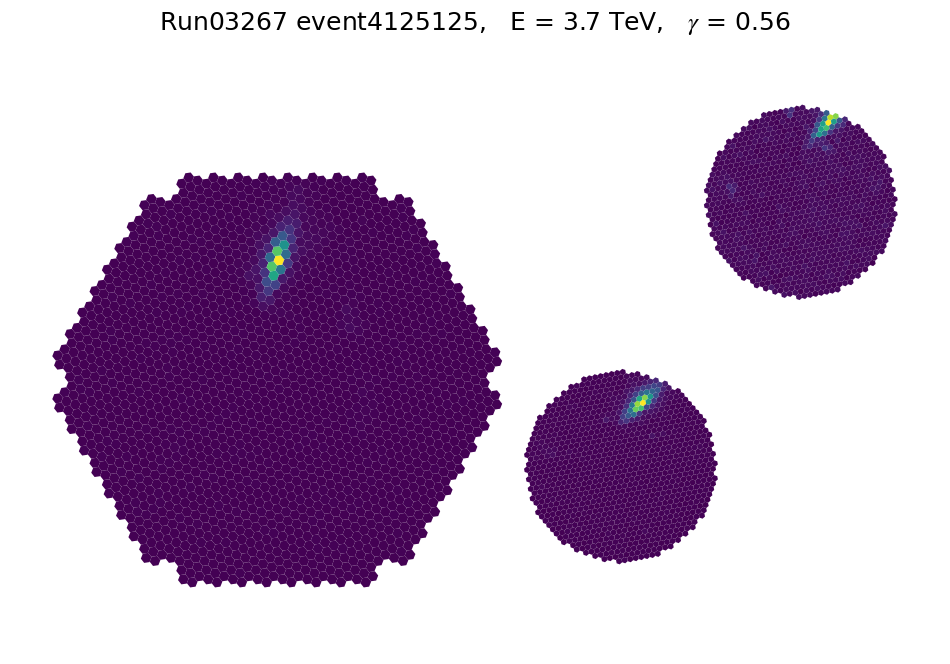

1 of 70


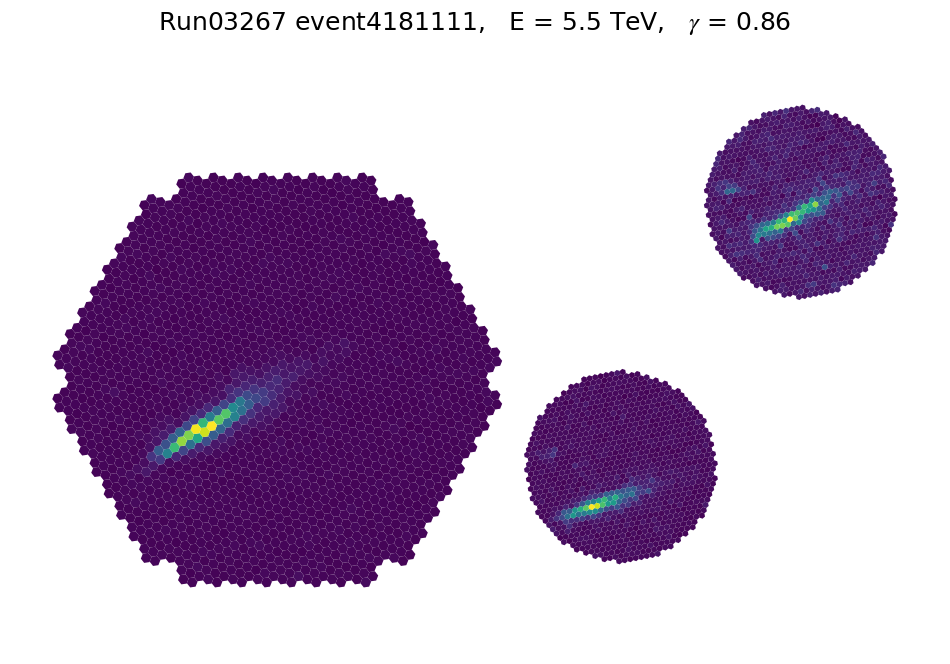

2 of 70


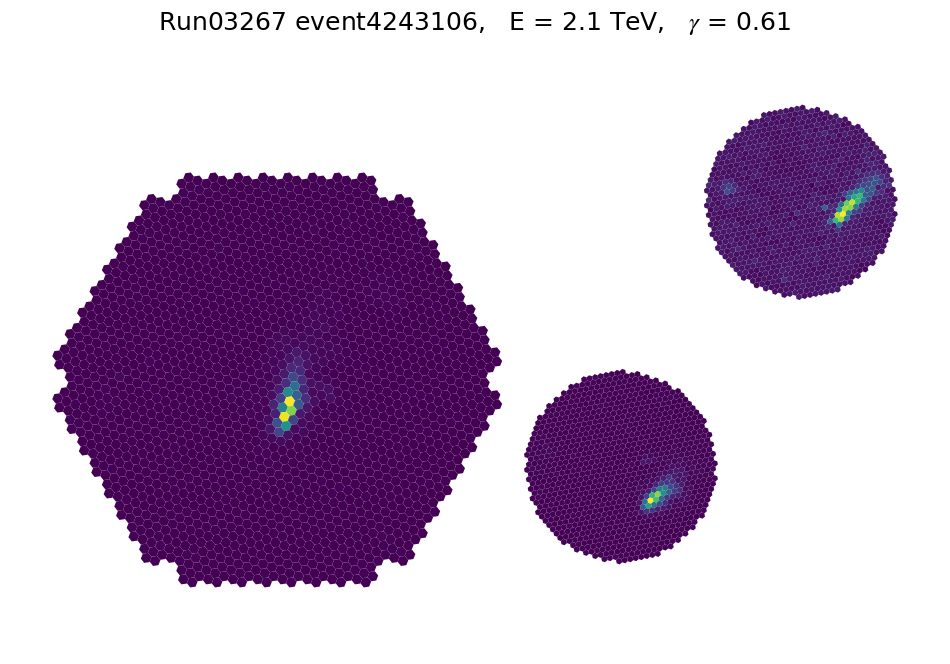

3 of 70


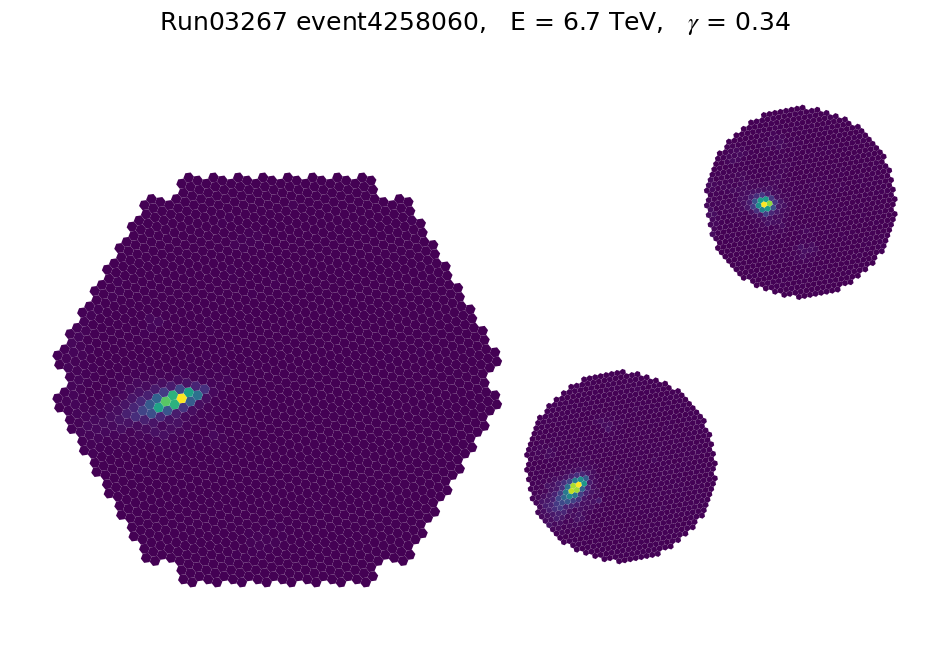

4 of 70


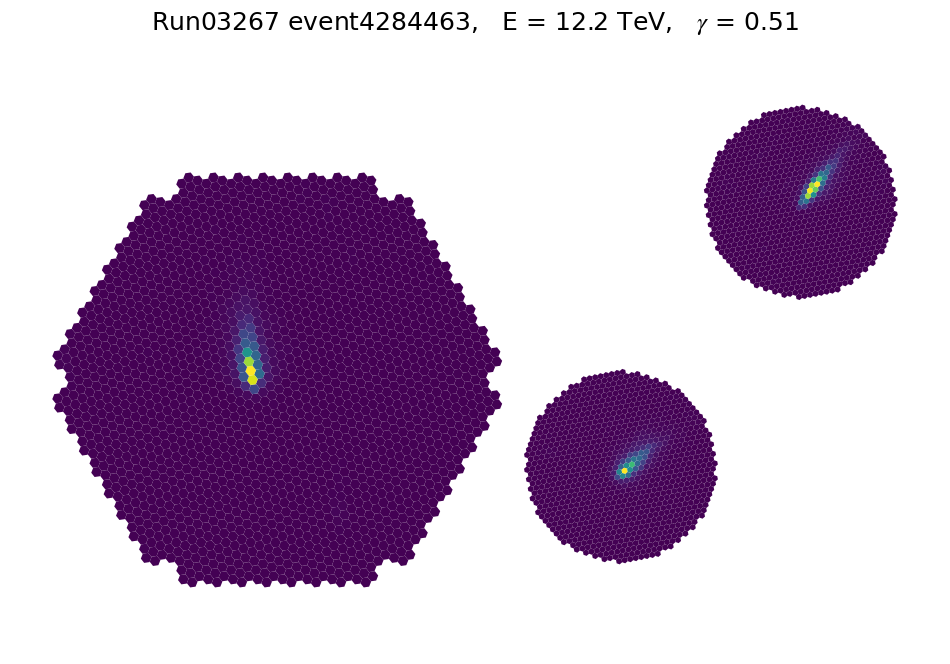

5 of 70


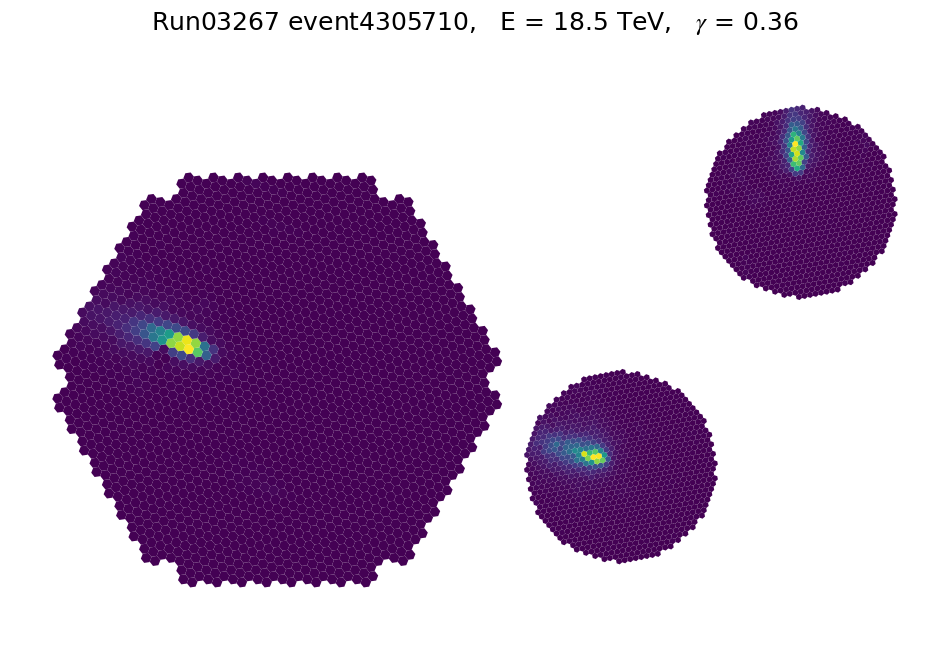

6 of 70


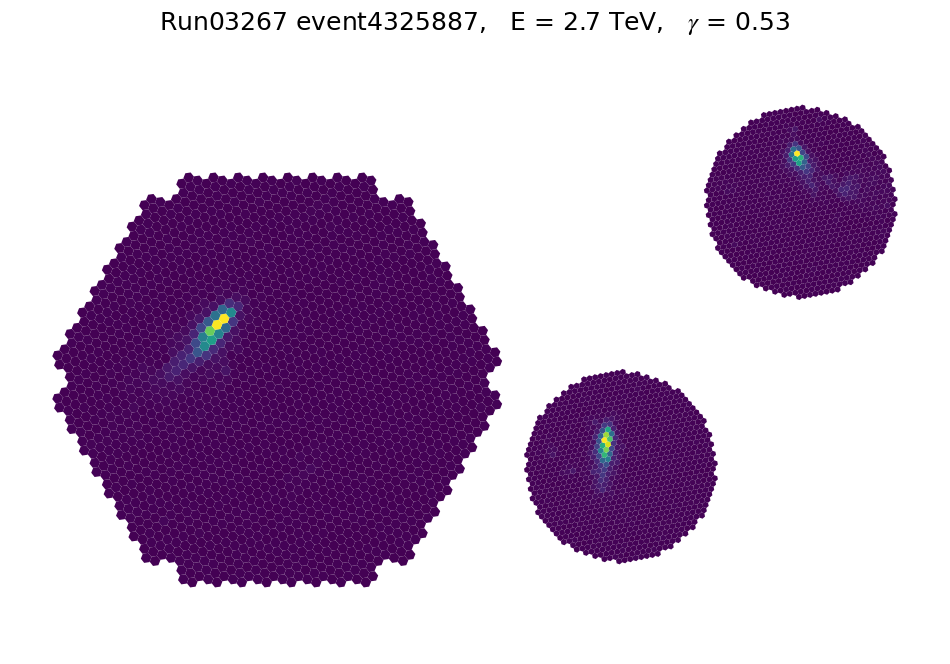

7 of 70


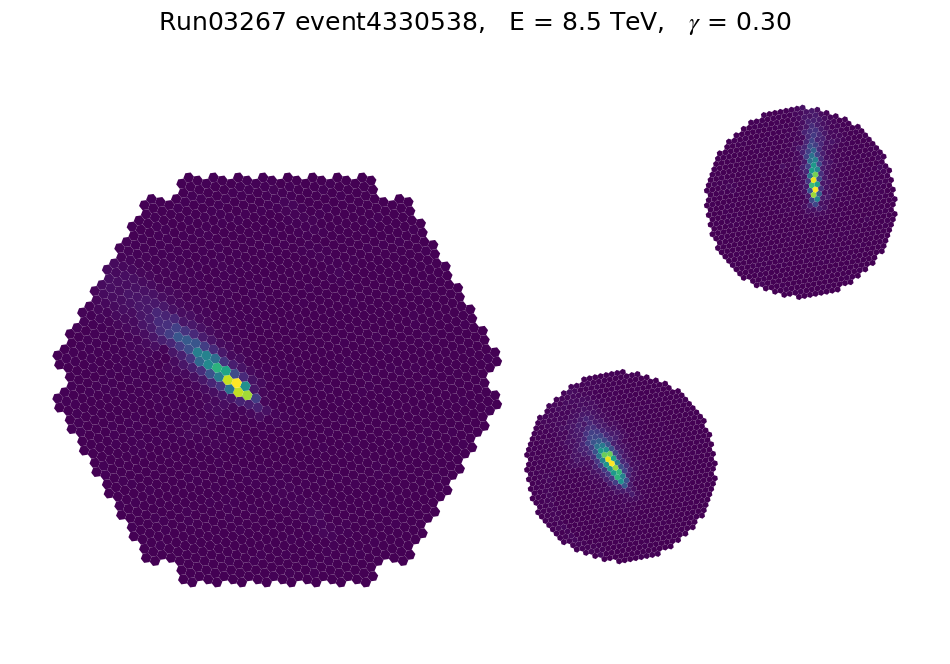

8 of 70


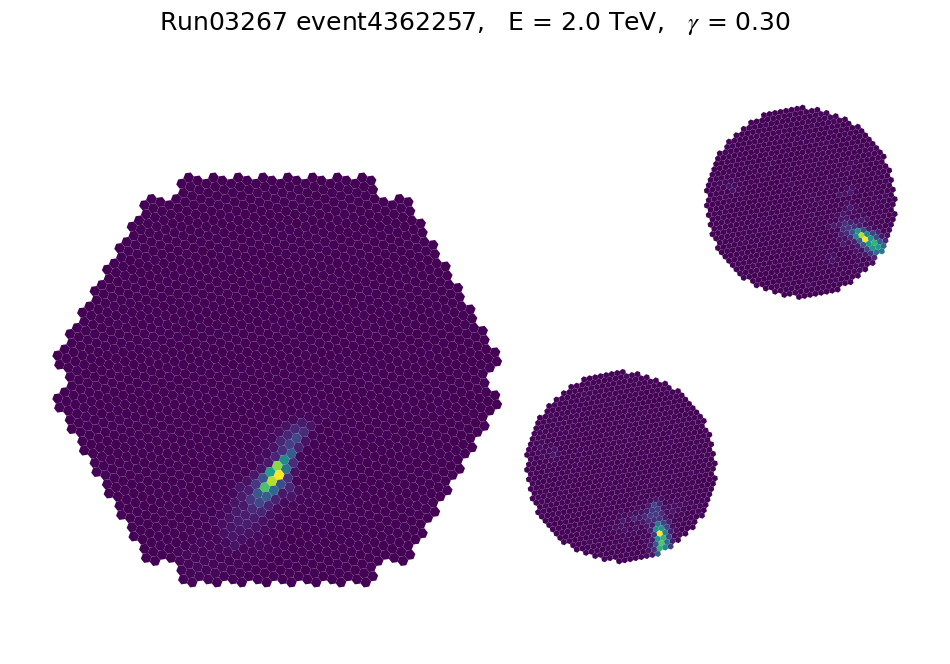

9 of 70


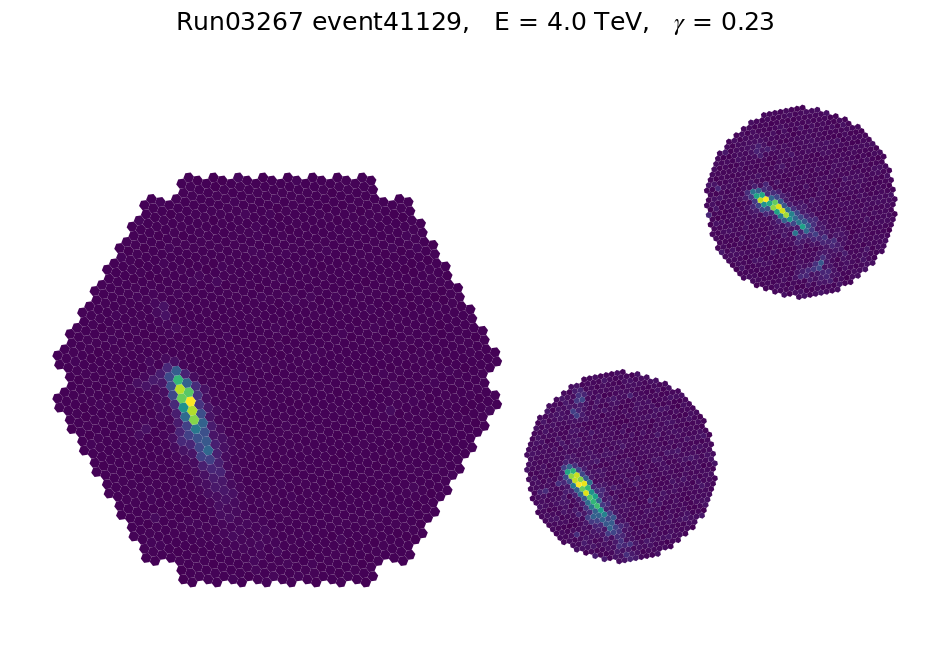

10 of 70


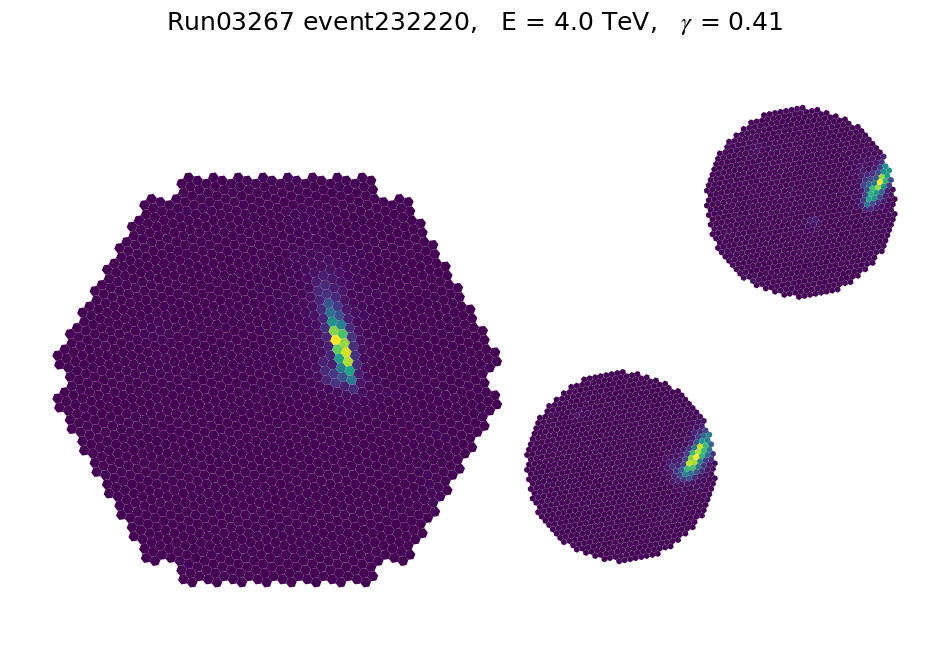

11 of 70


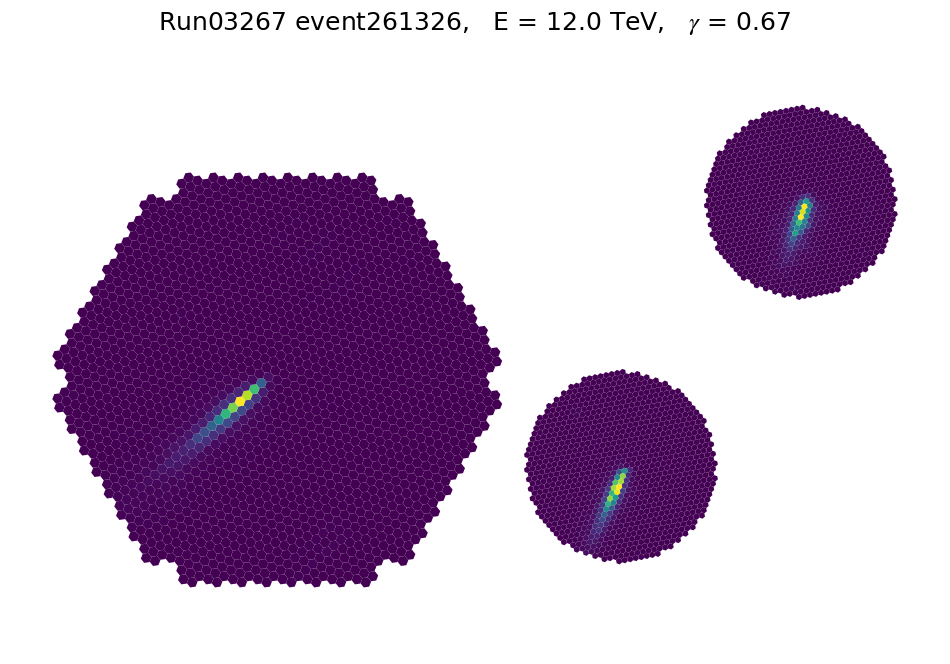

12 of 70


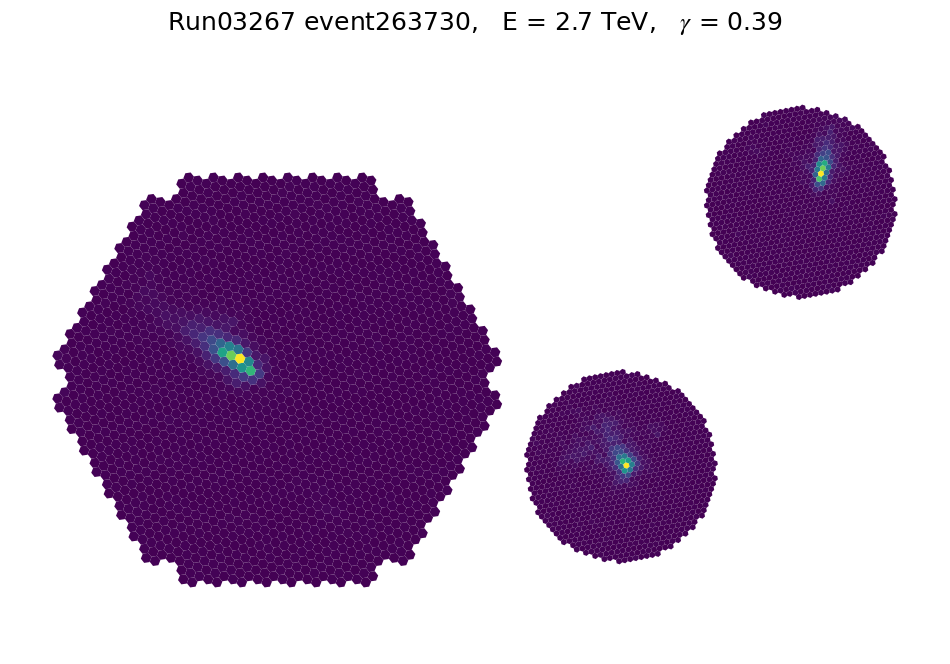

13 of 70


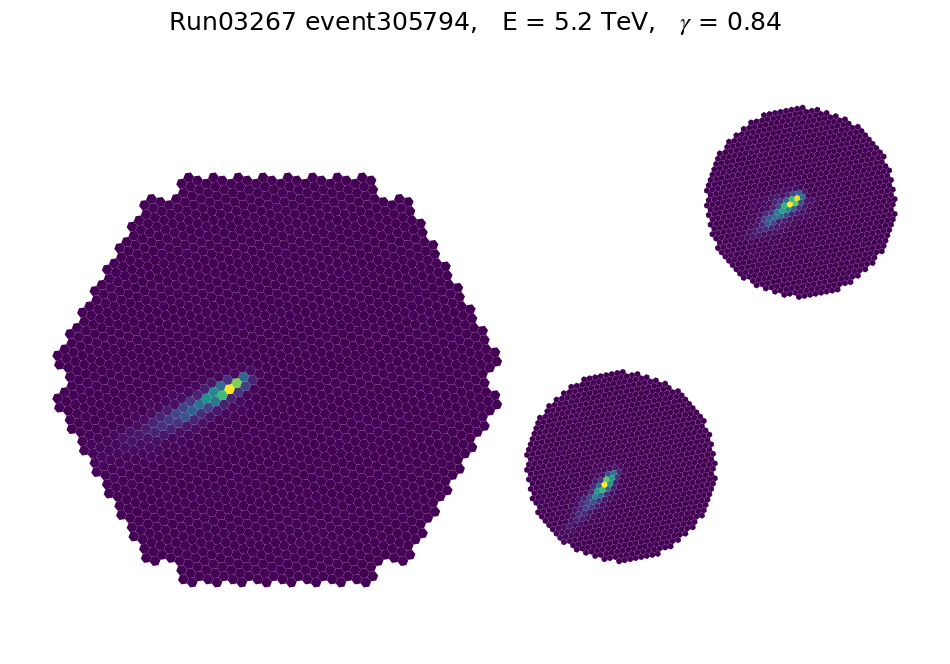

14 of 70


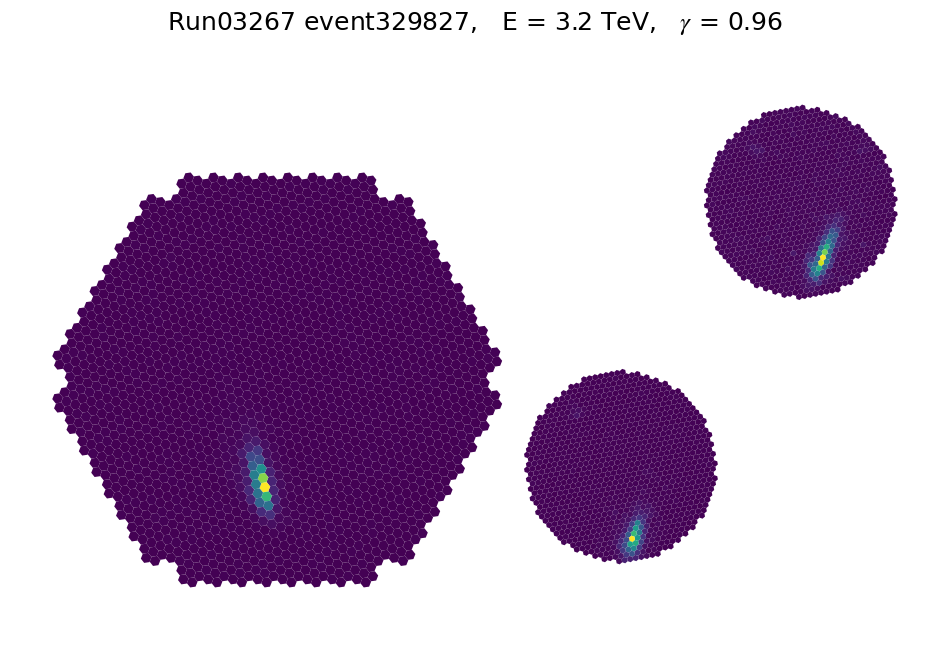

15 of 70


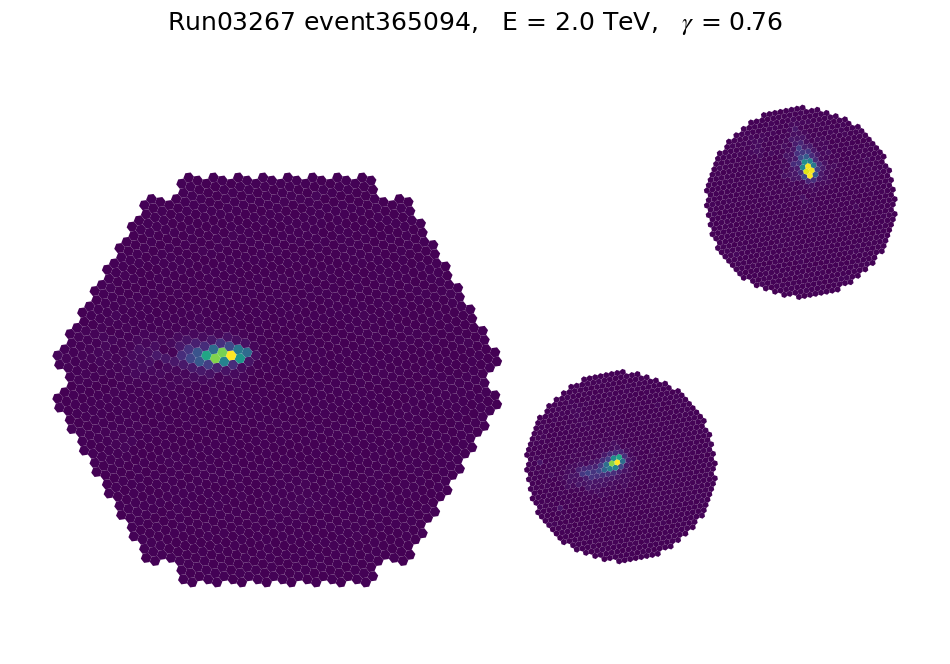

16 of 70


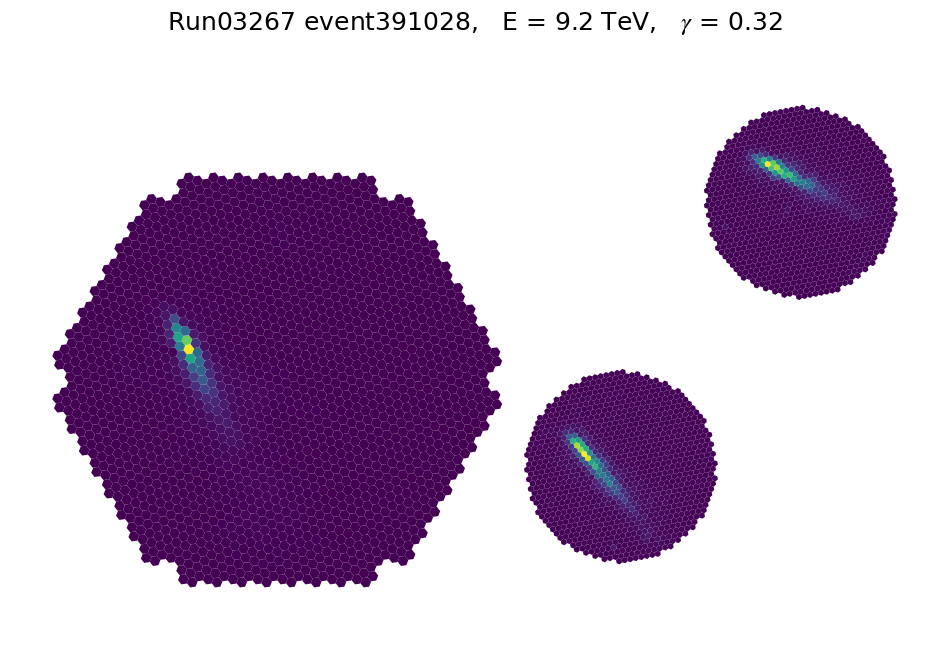

17 of 70


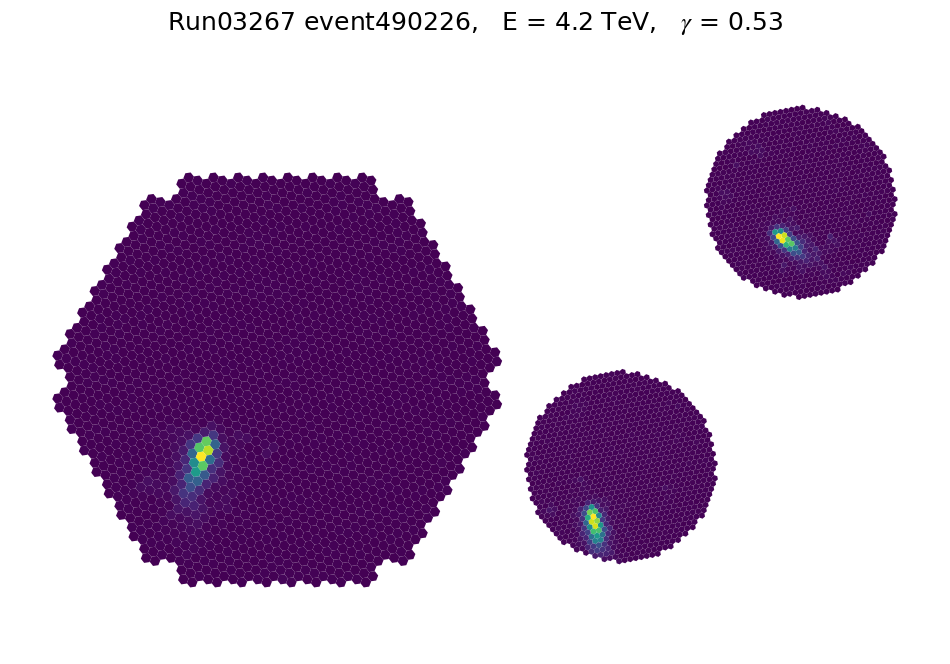

18 of 70


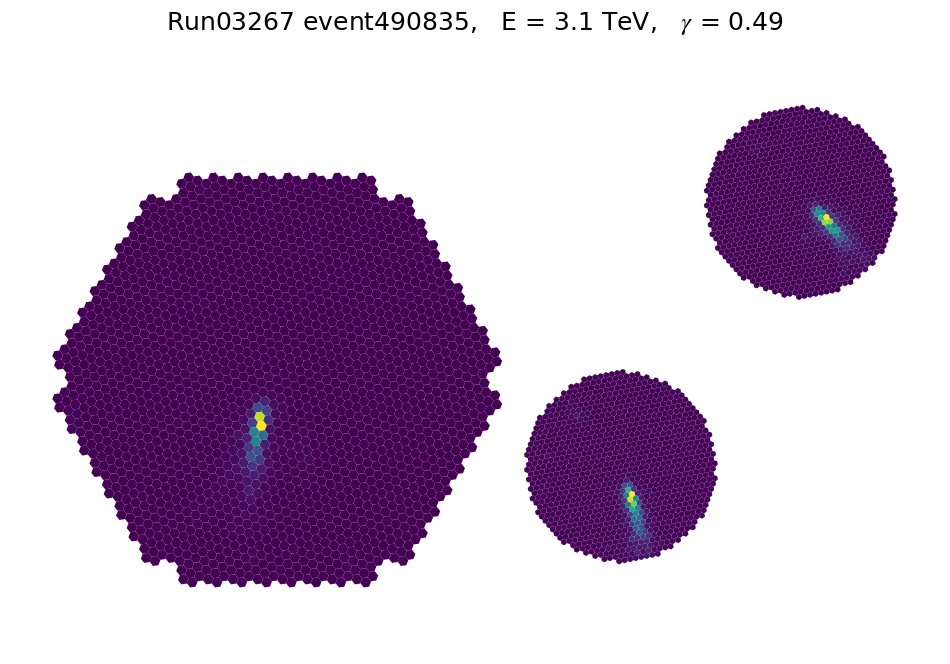

19 of 70


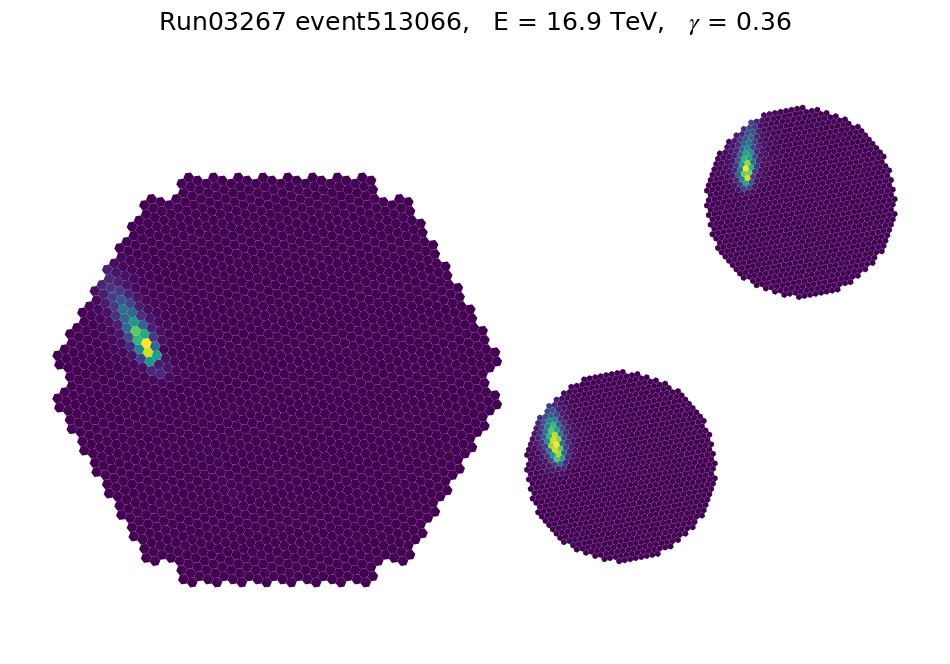

20 of 70


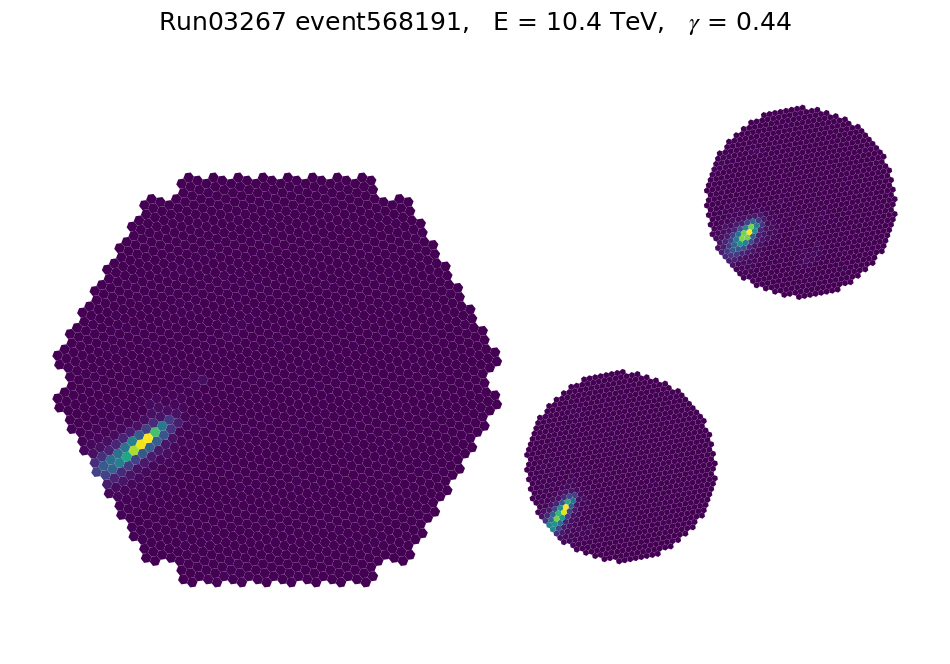

21 of 70


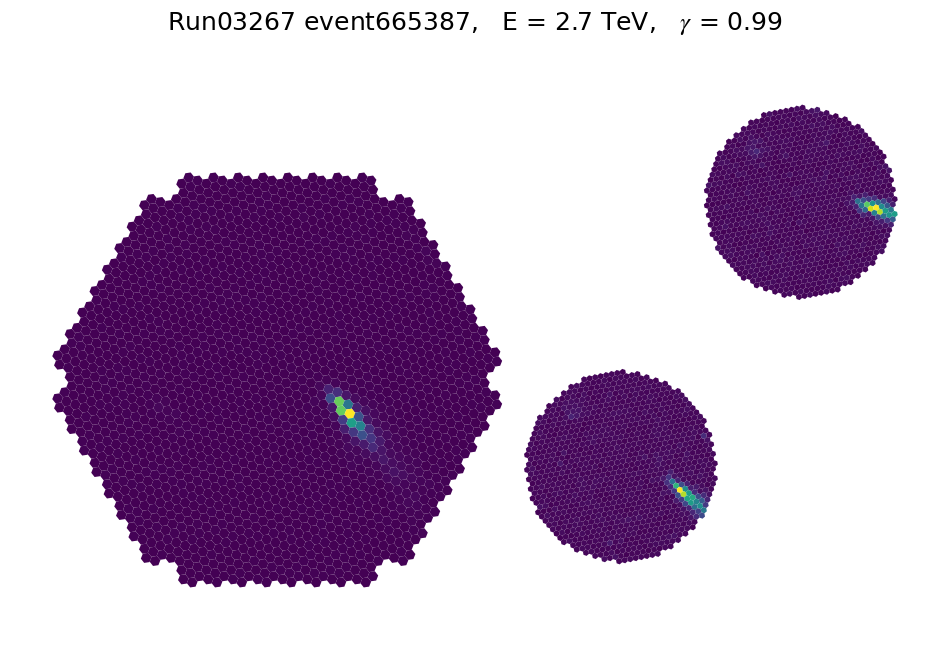

22 of 70


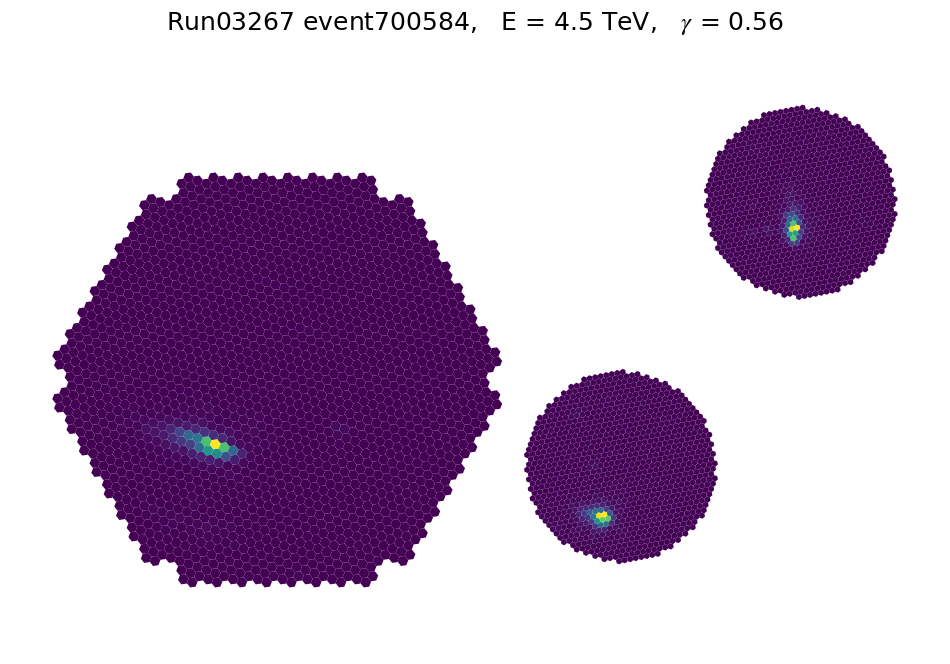

23 of 70


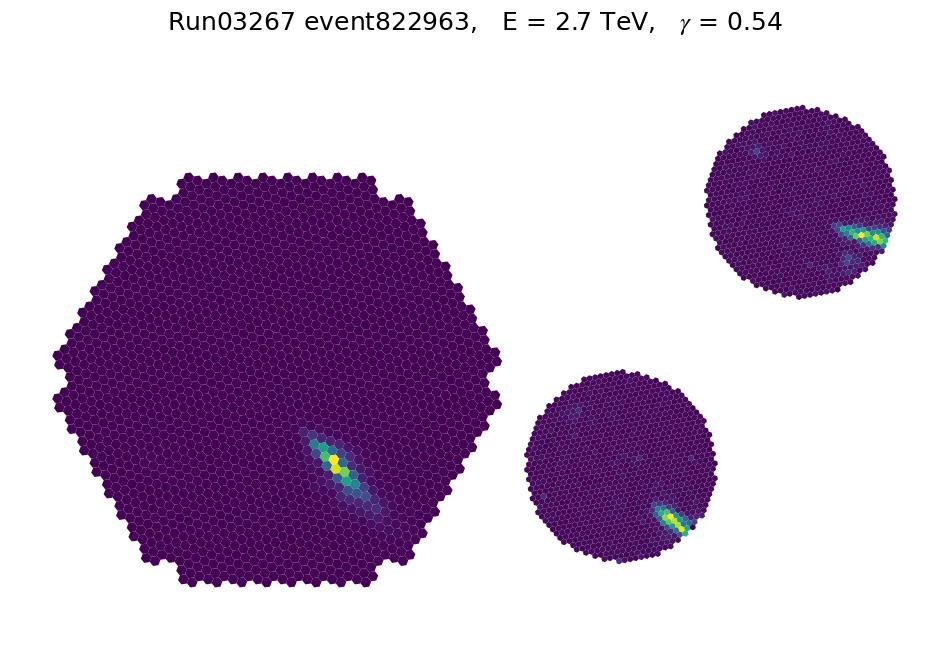

24 of 70


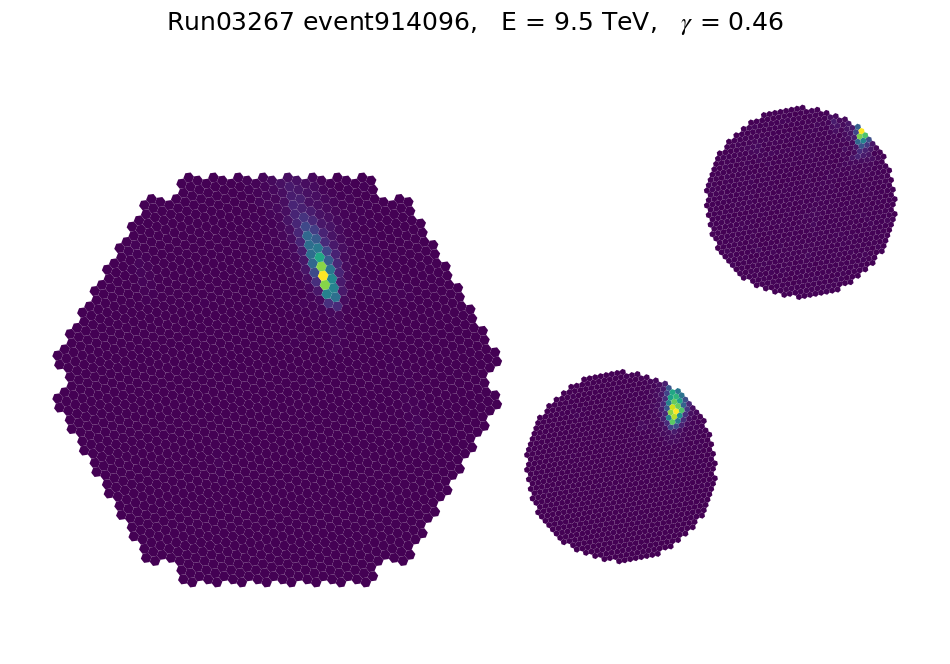

25 of 70


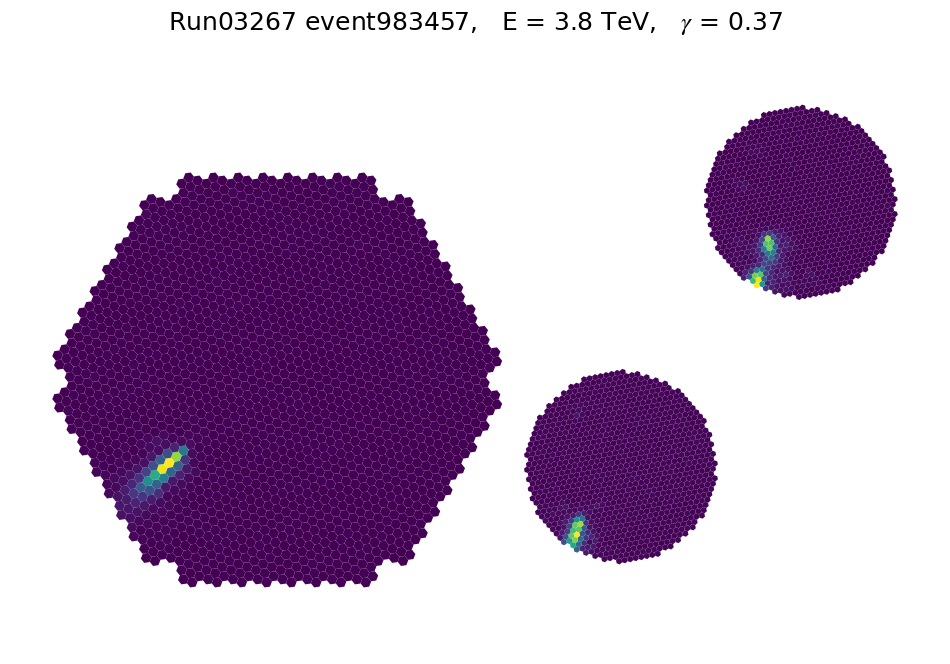

26 of 70


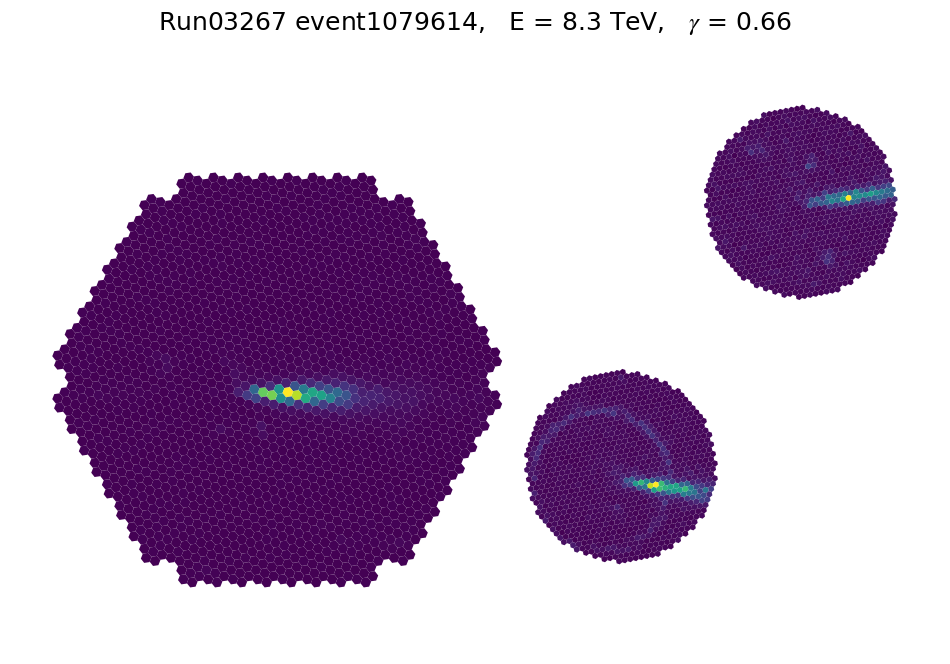

27 of 70


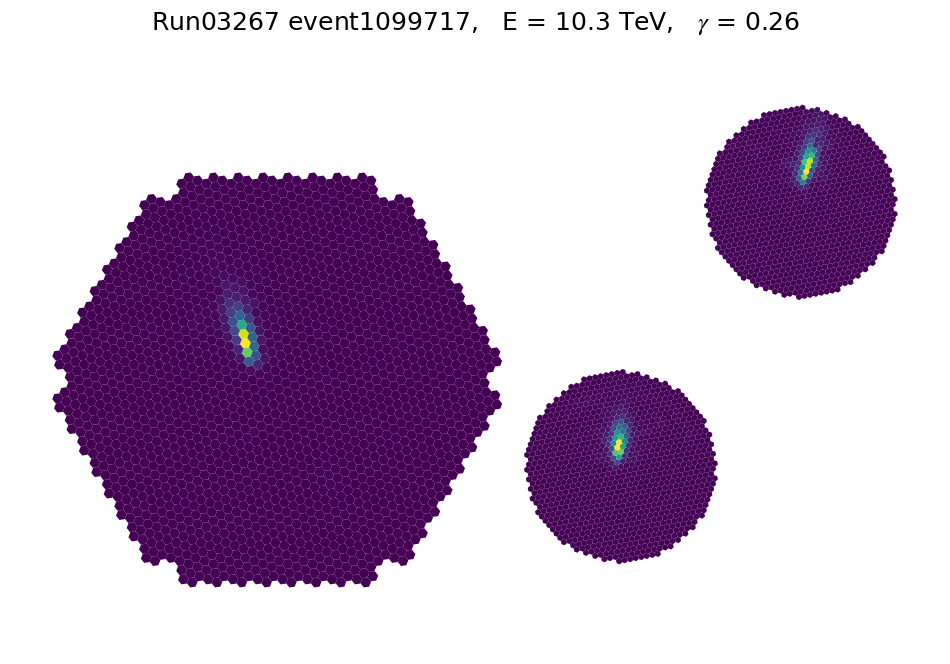

28 of 70


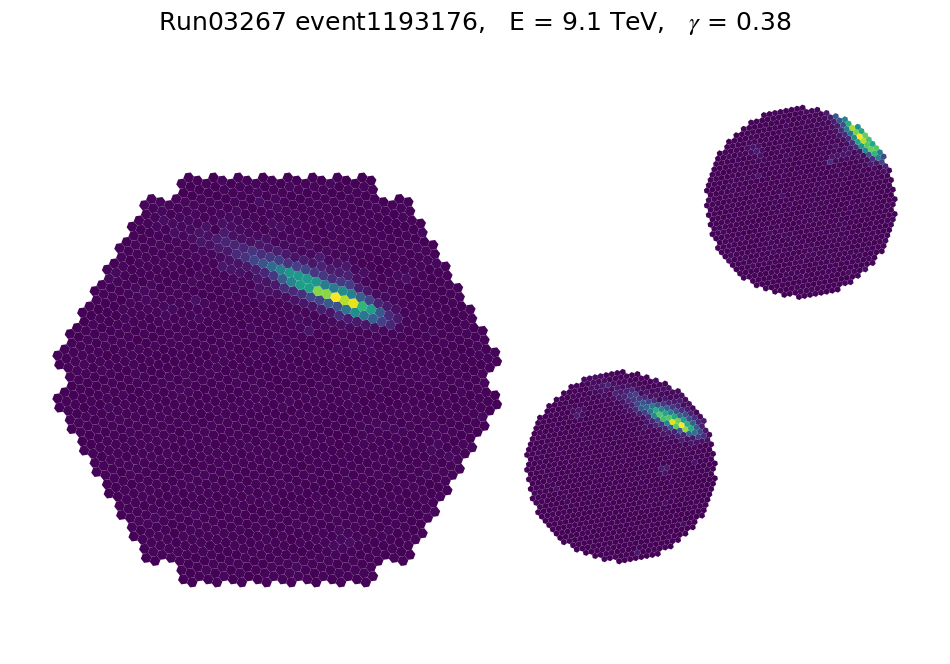

29 of 70


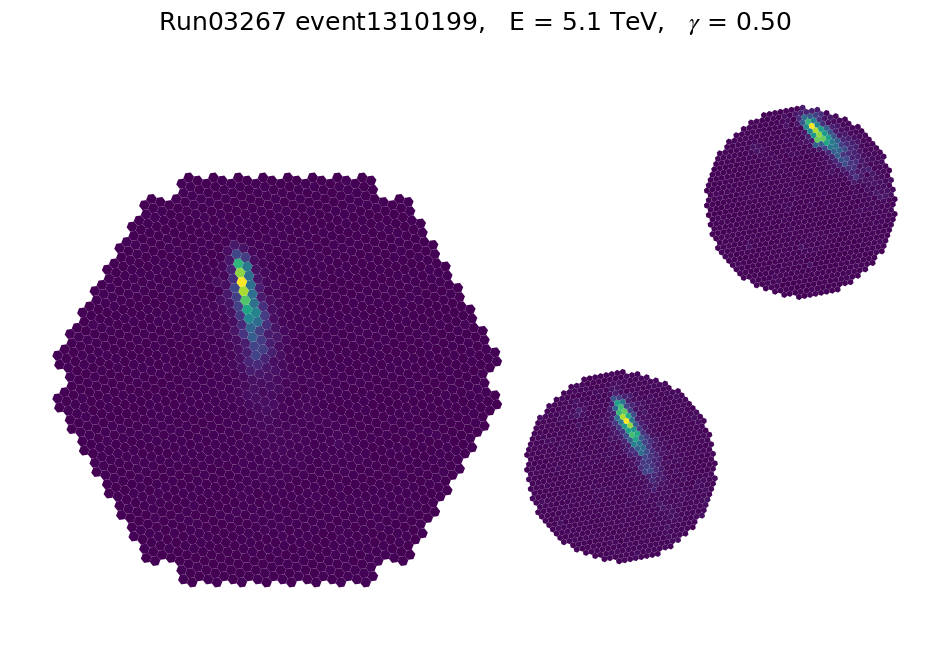

30 of 70


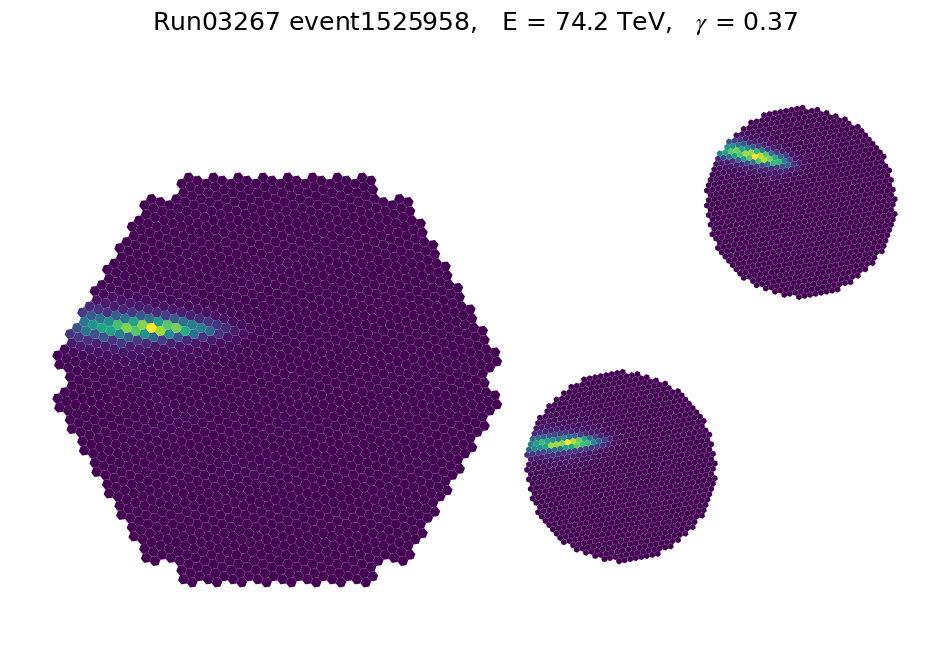

31 of 70


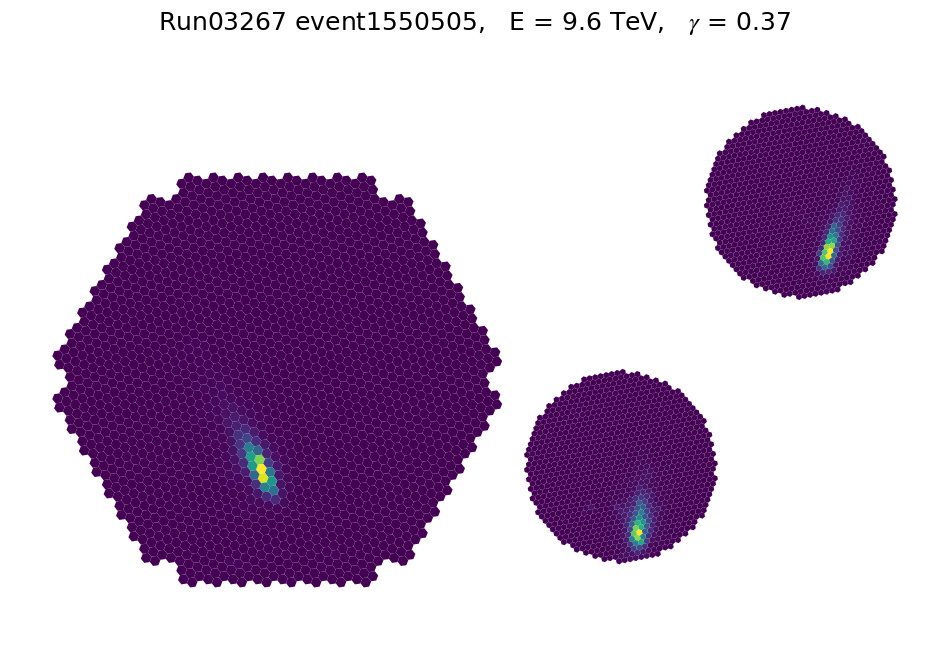

32 of 70


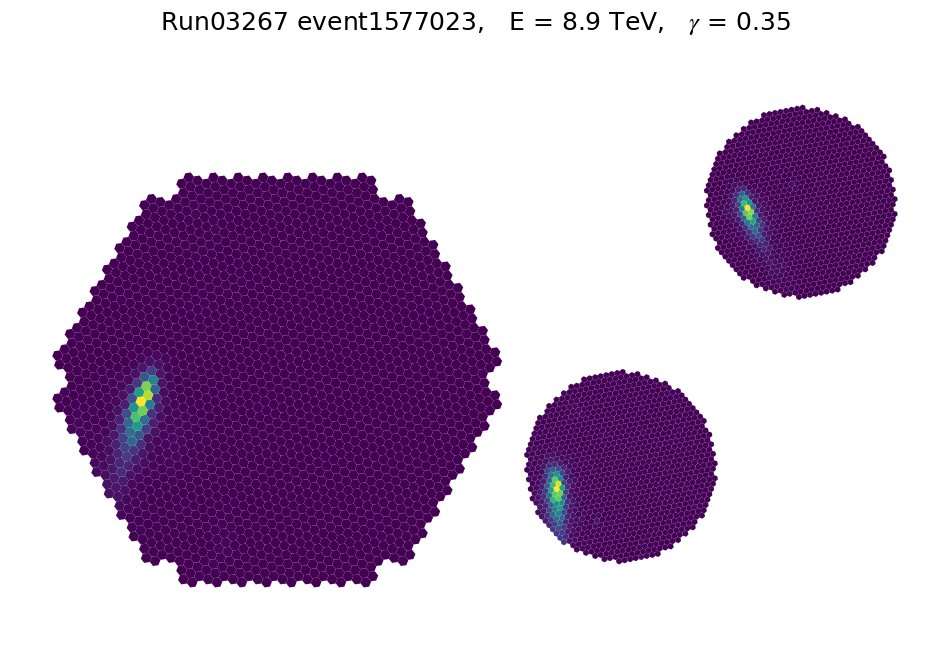

33 of 70


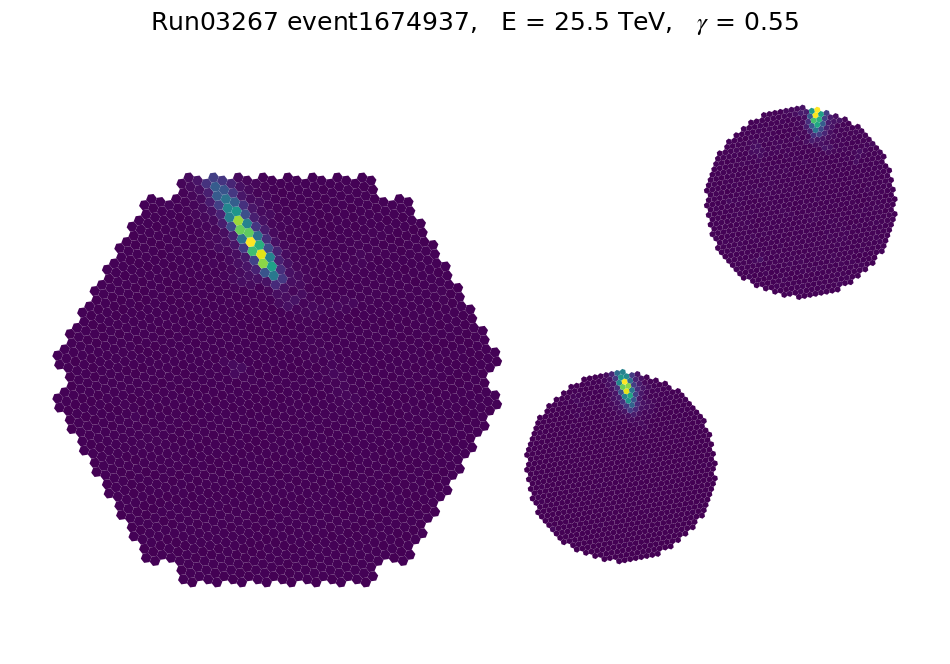

34 of 70


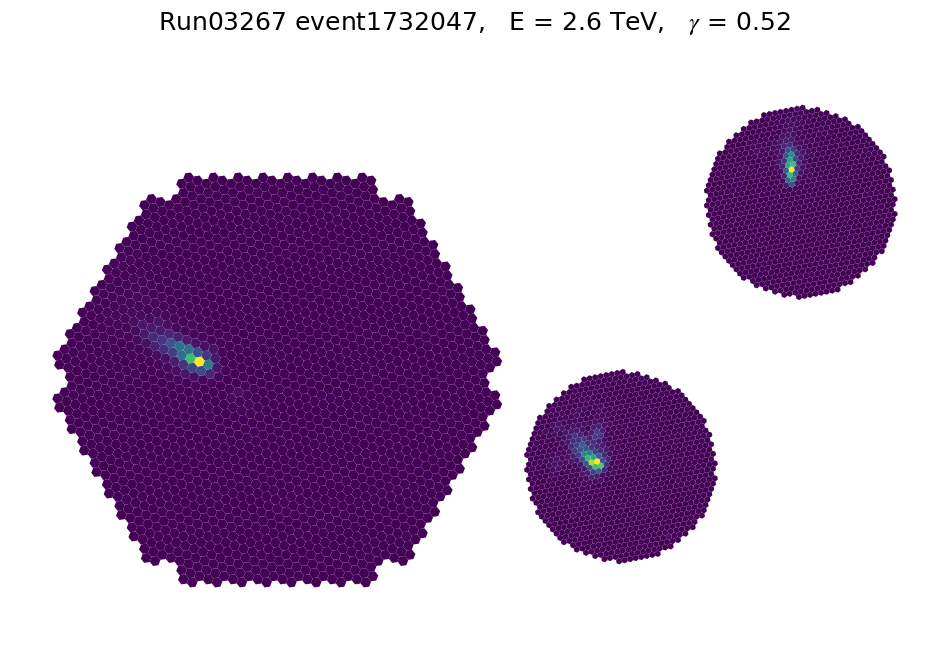

35 of 70


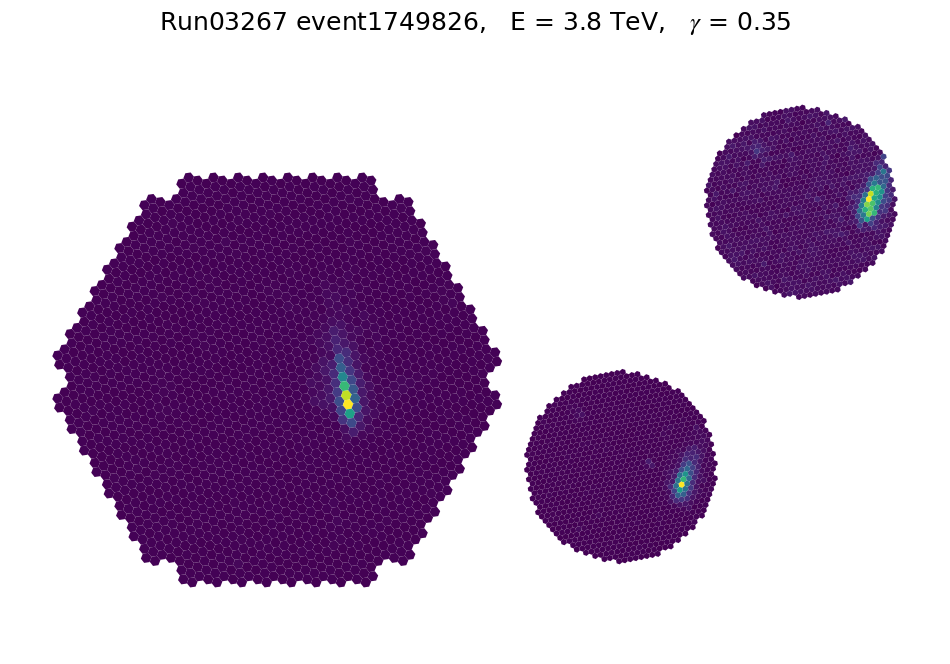

36 of 70


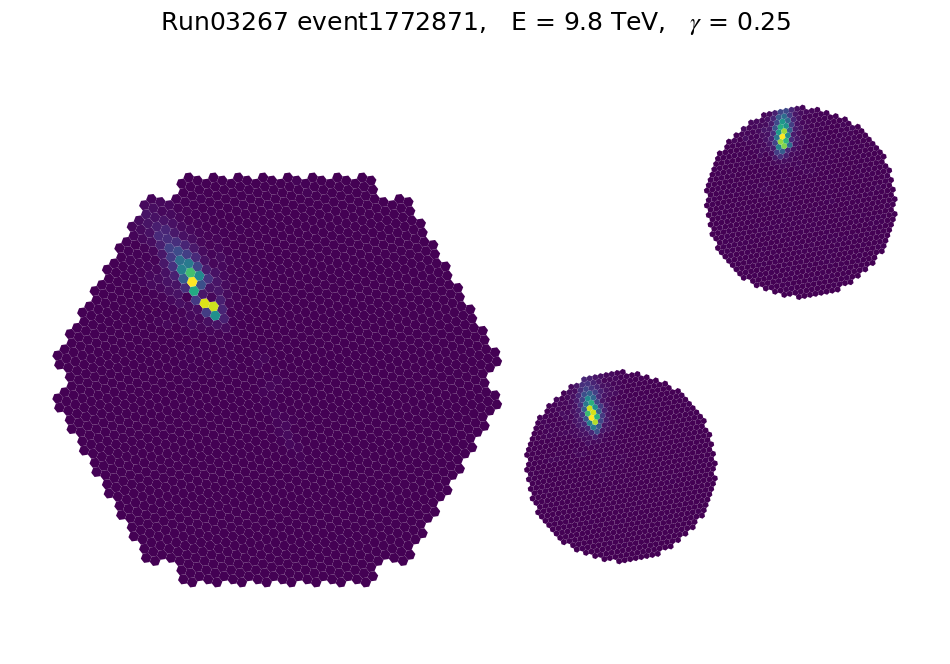

37 of 70


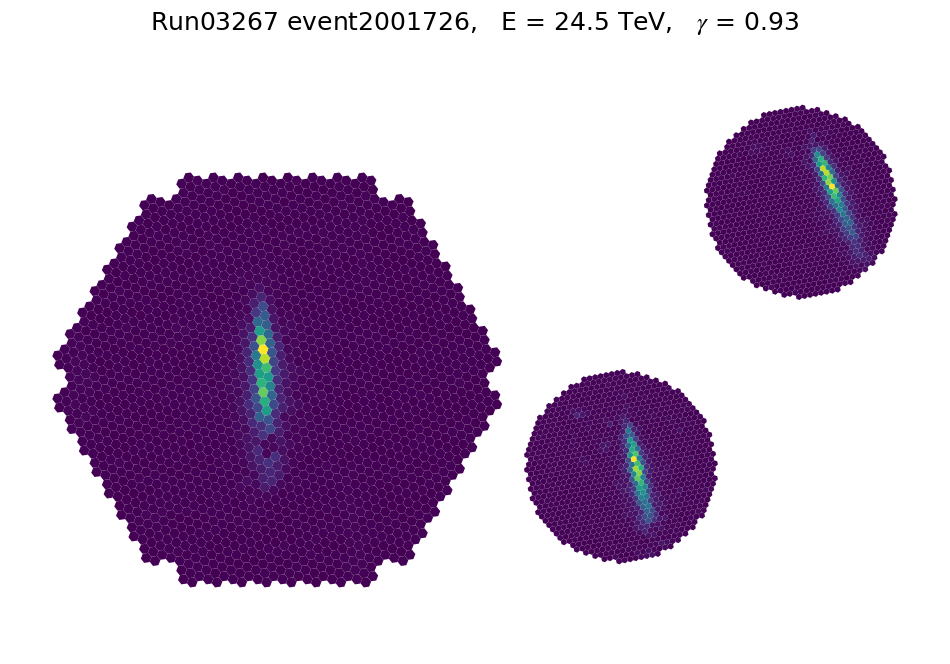

38 of 70


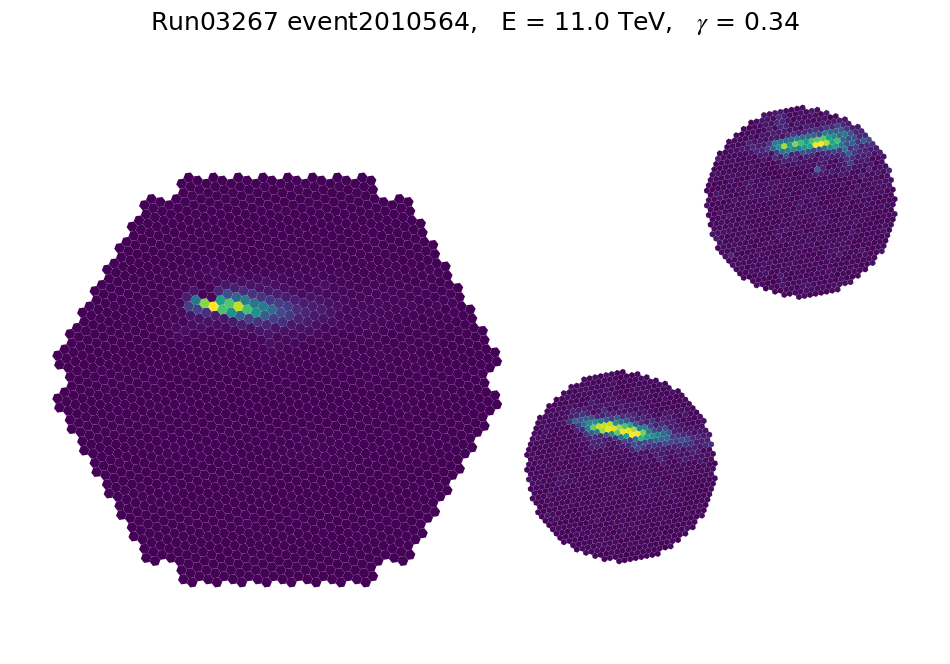

39 of 70


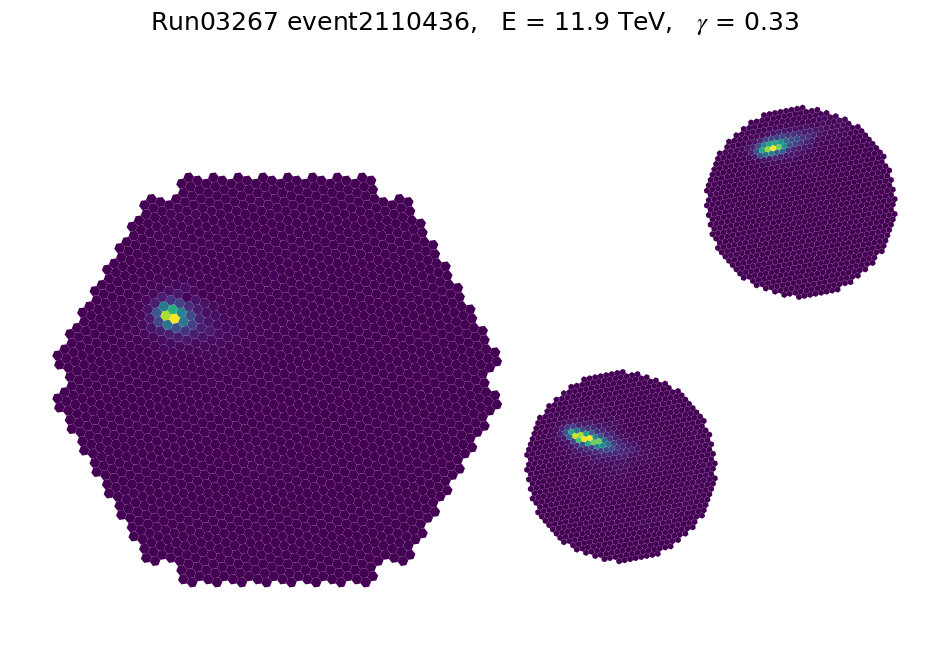

40 of 70


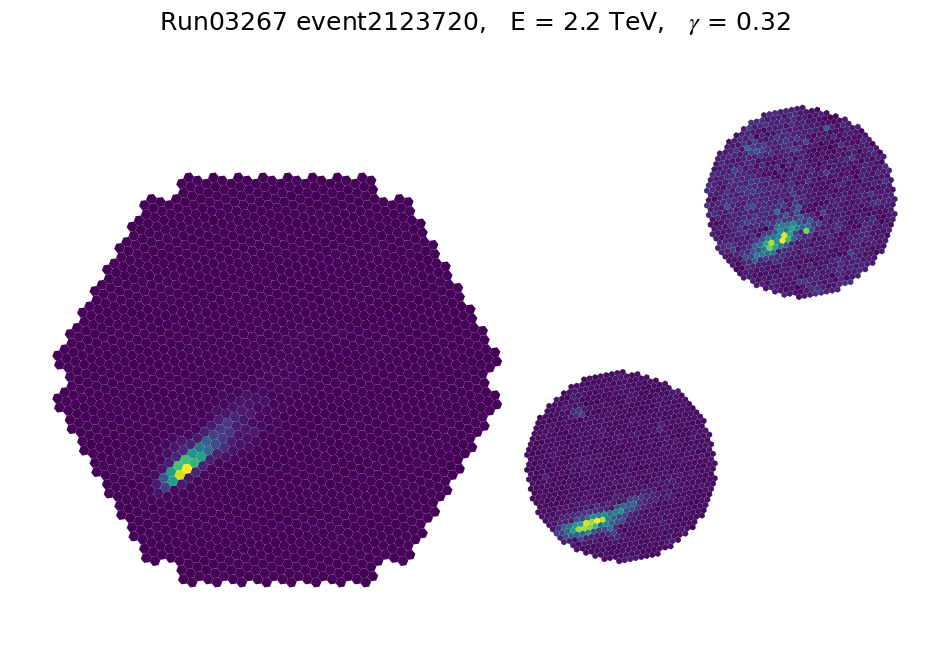

41 of 70


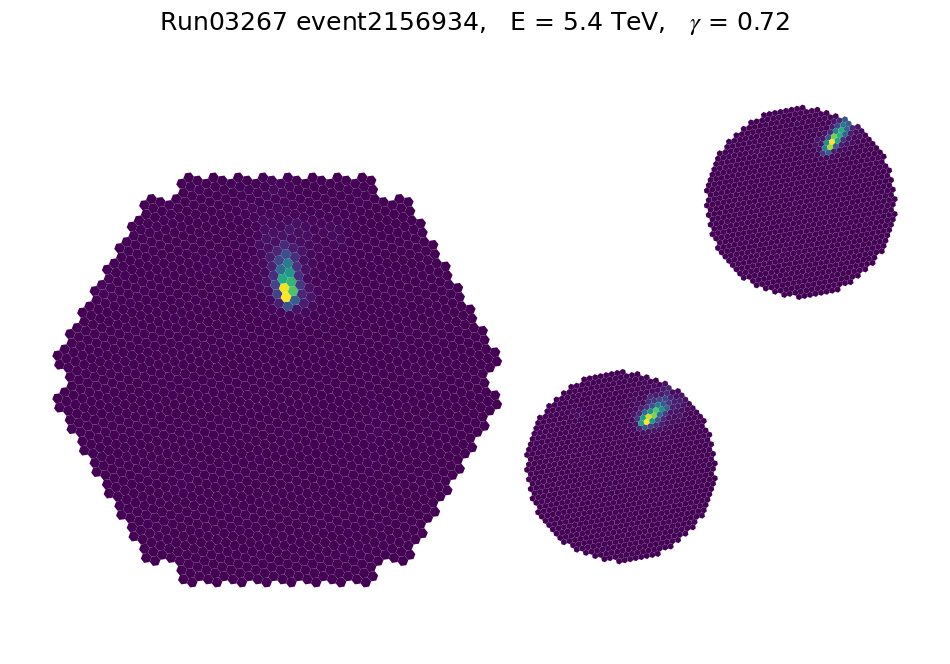

42 of 70


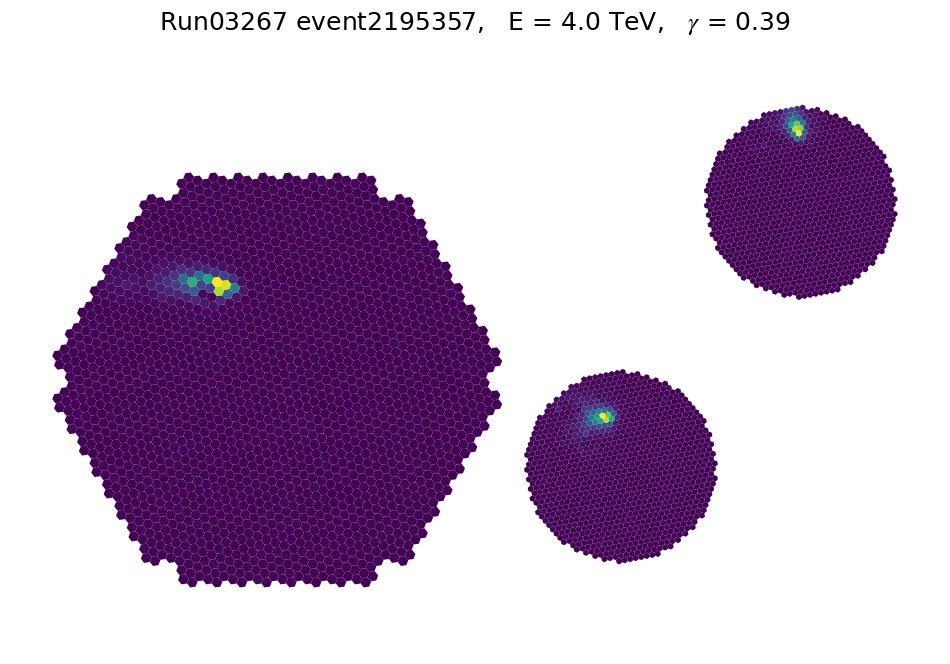

43 of 70


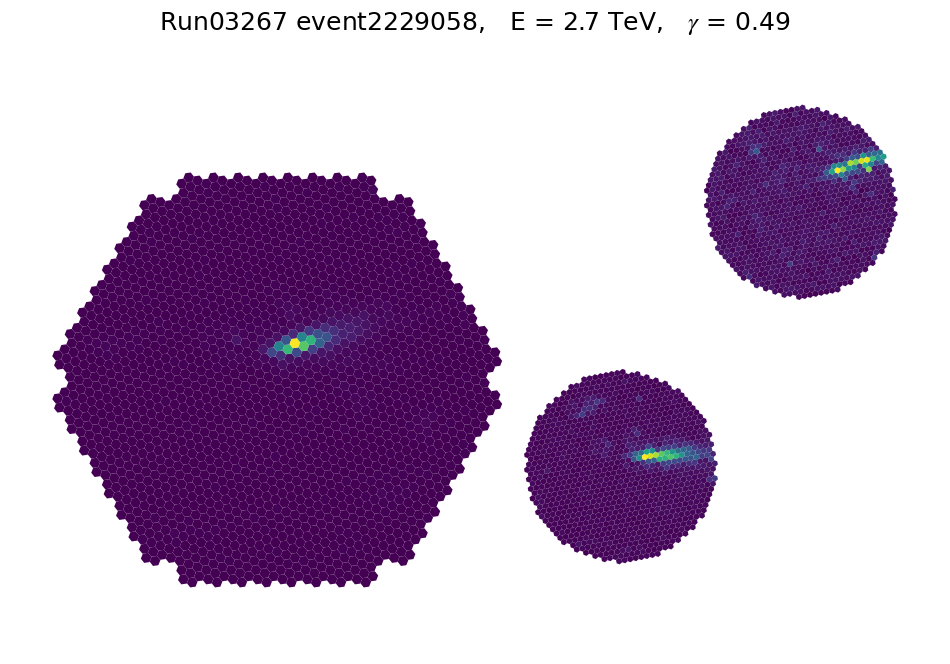

44 of 70


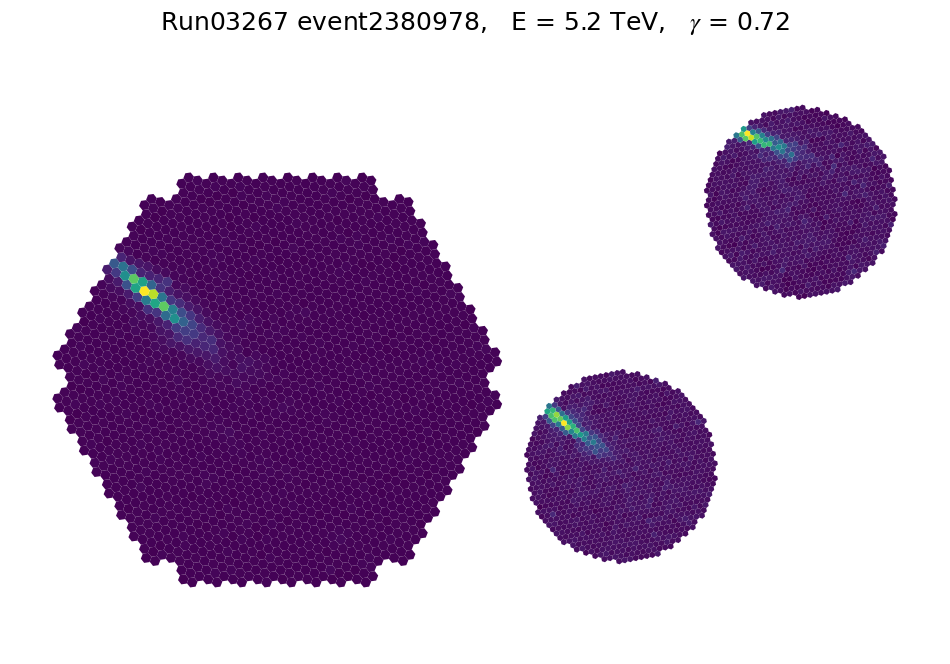

45 of 70


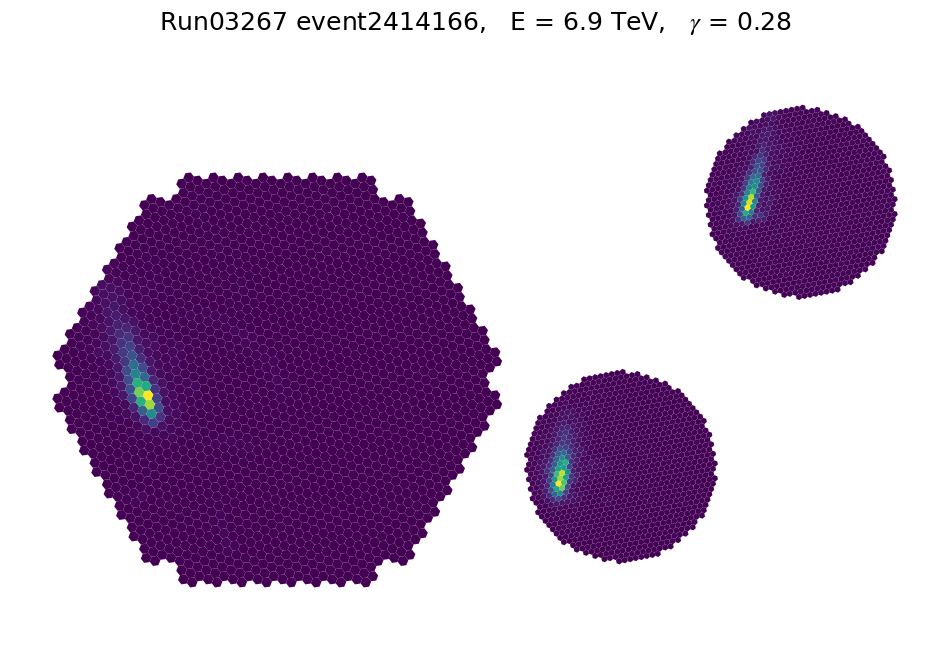

46 of 70


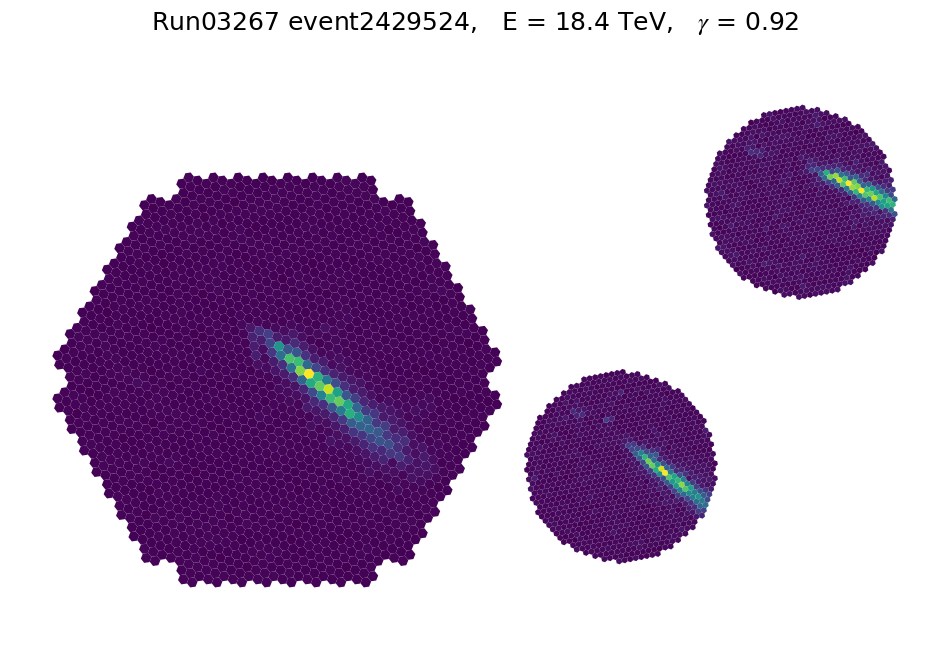

47 of 70


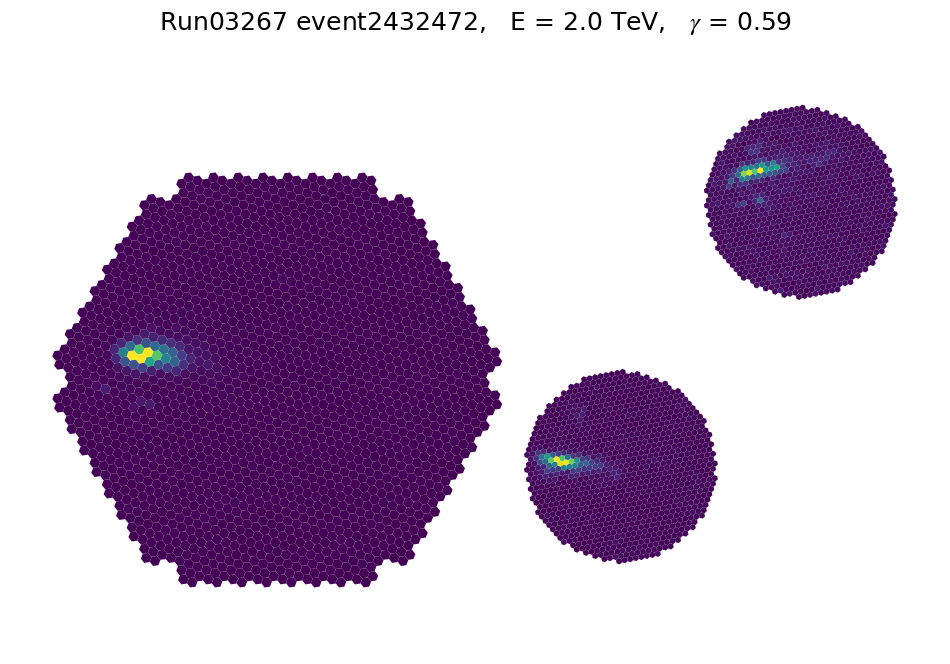

48 of 70


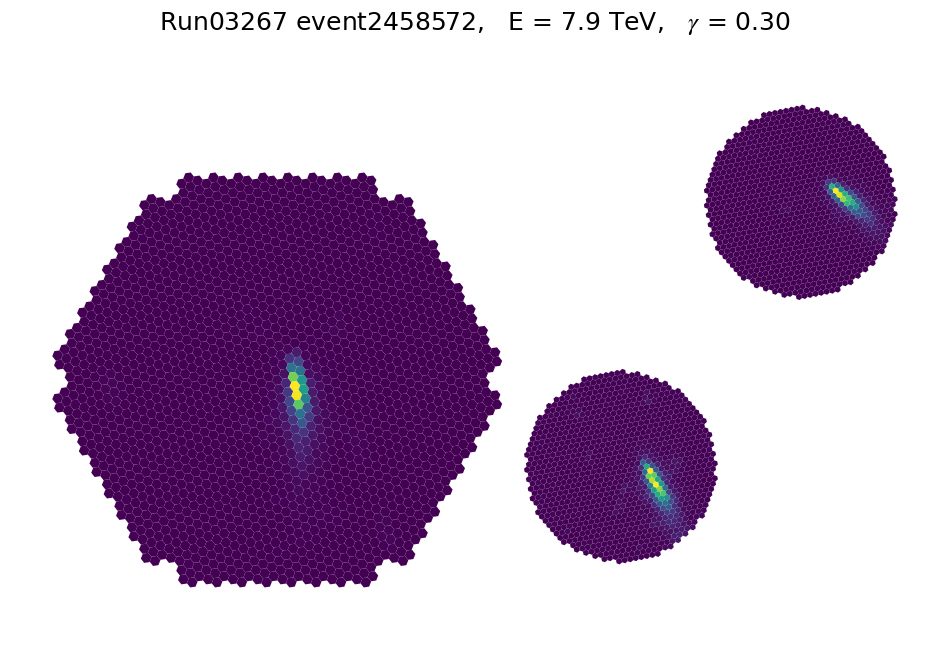

49 of 70


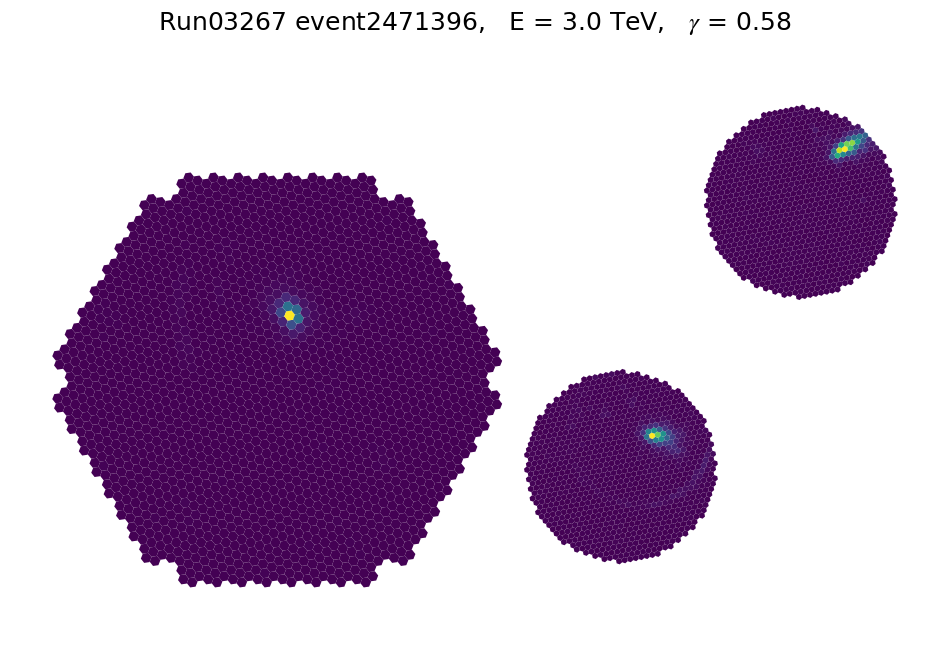

50 of 70


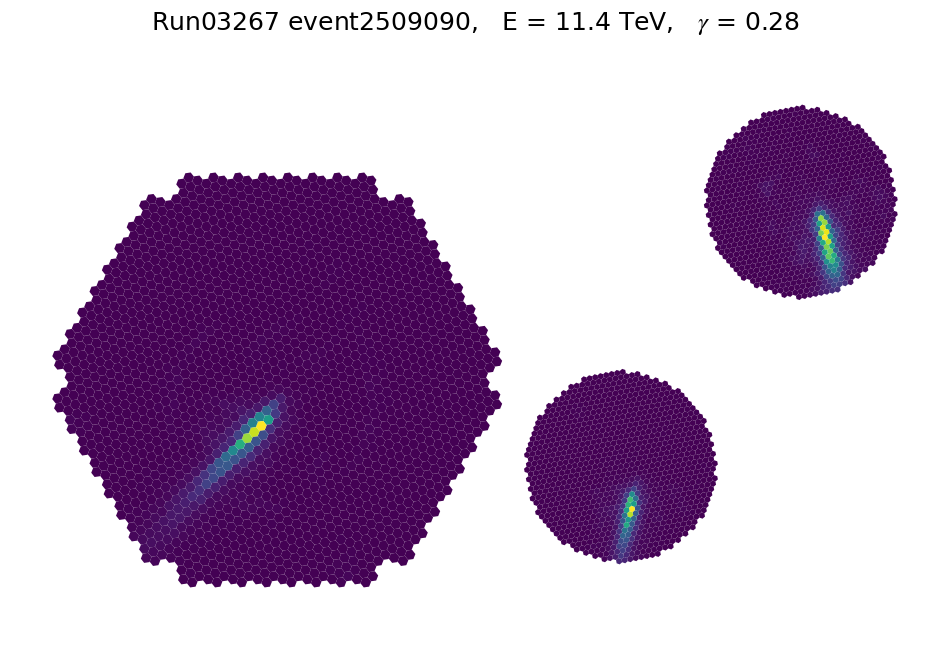

51 of 70


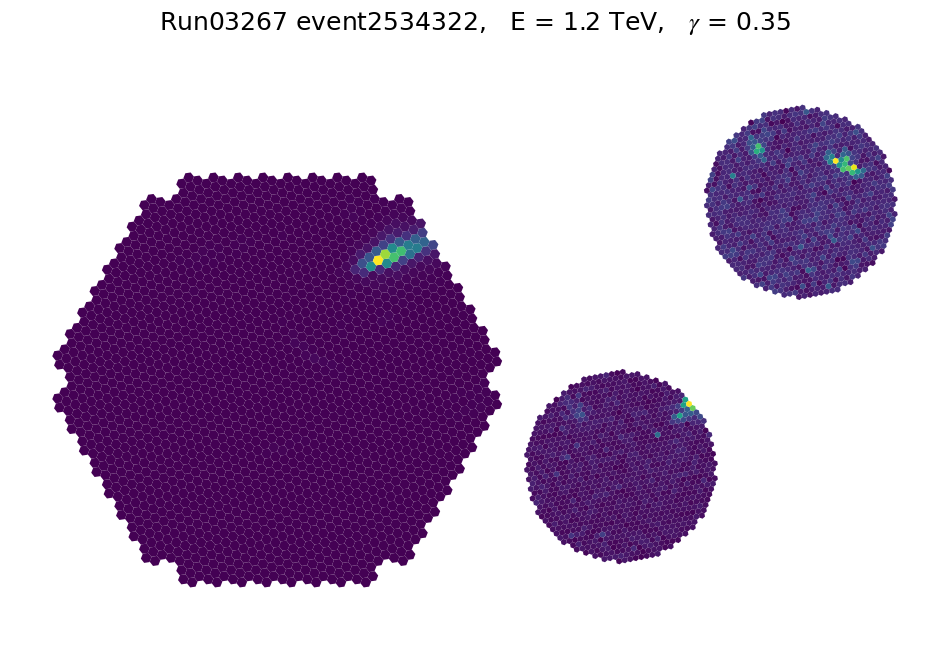

52 of 70


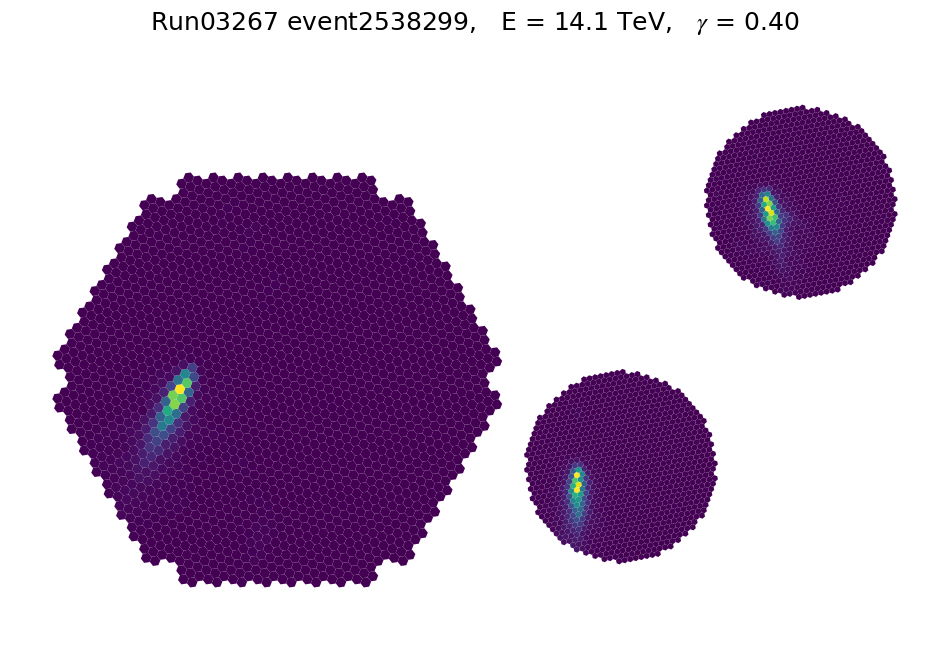

53 of 70


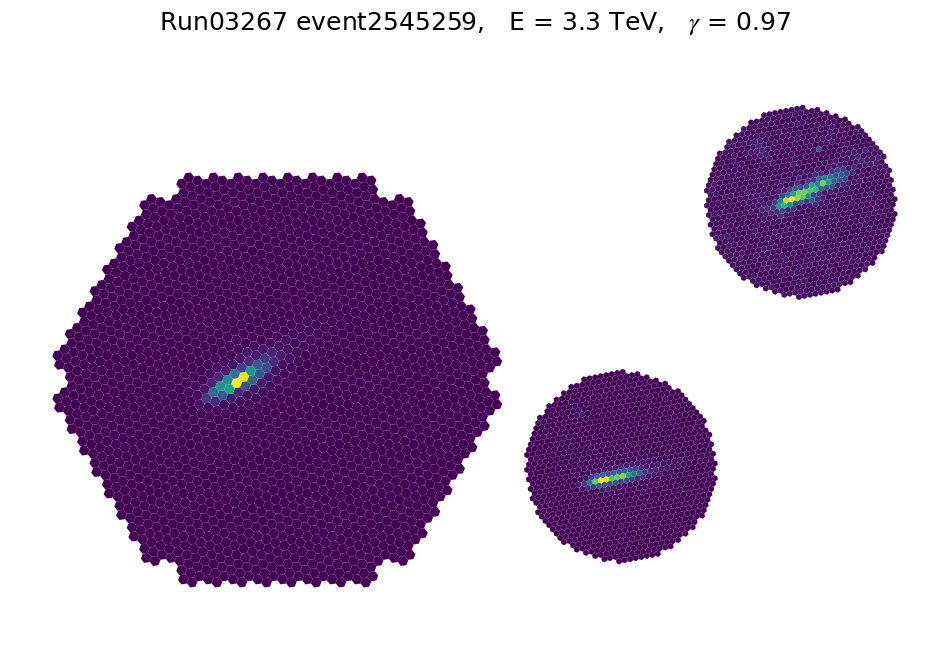

54 of 70


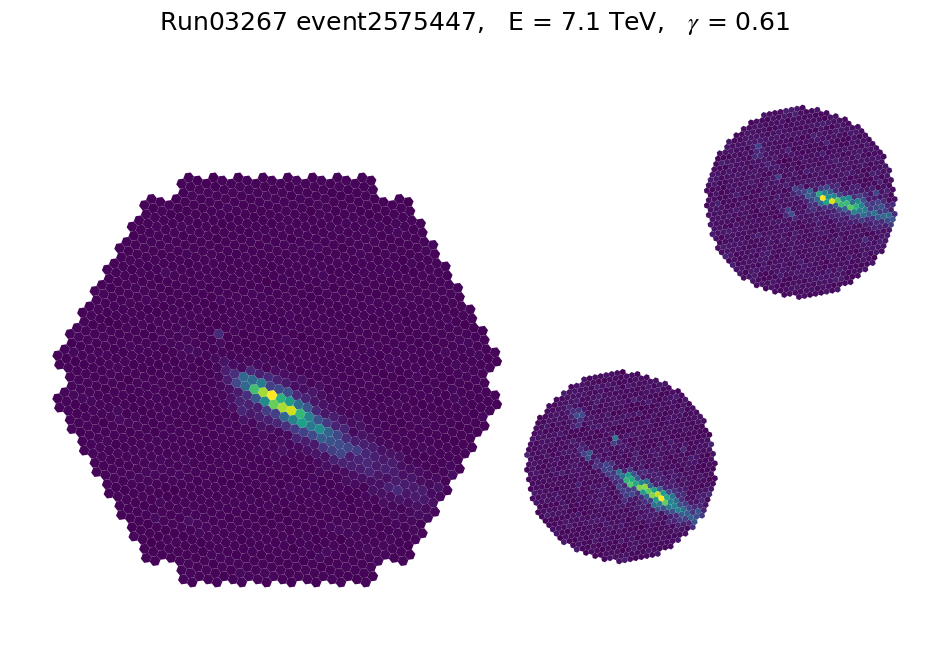

55 of 70


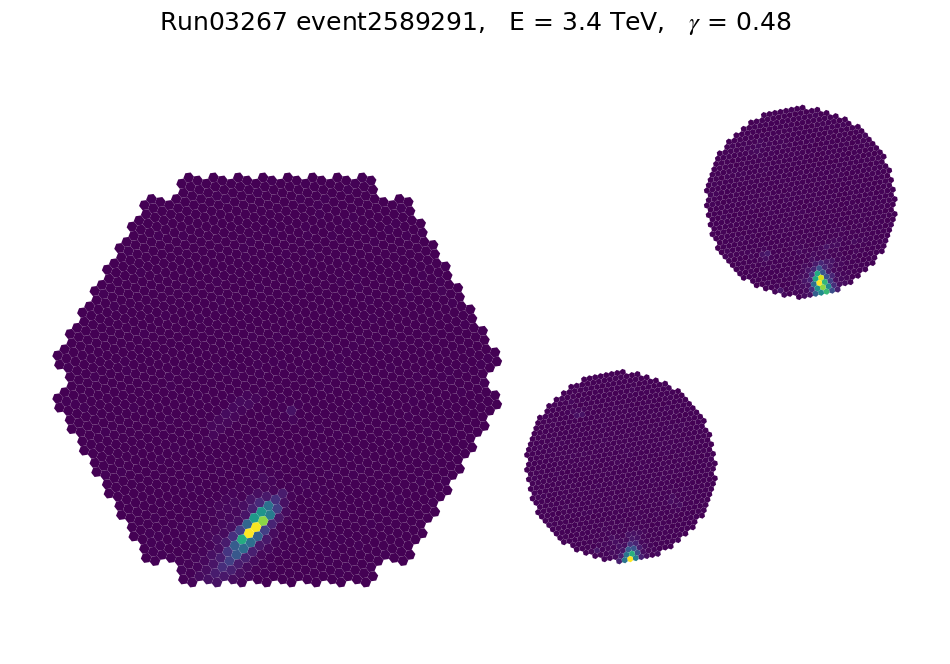

56 of 70


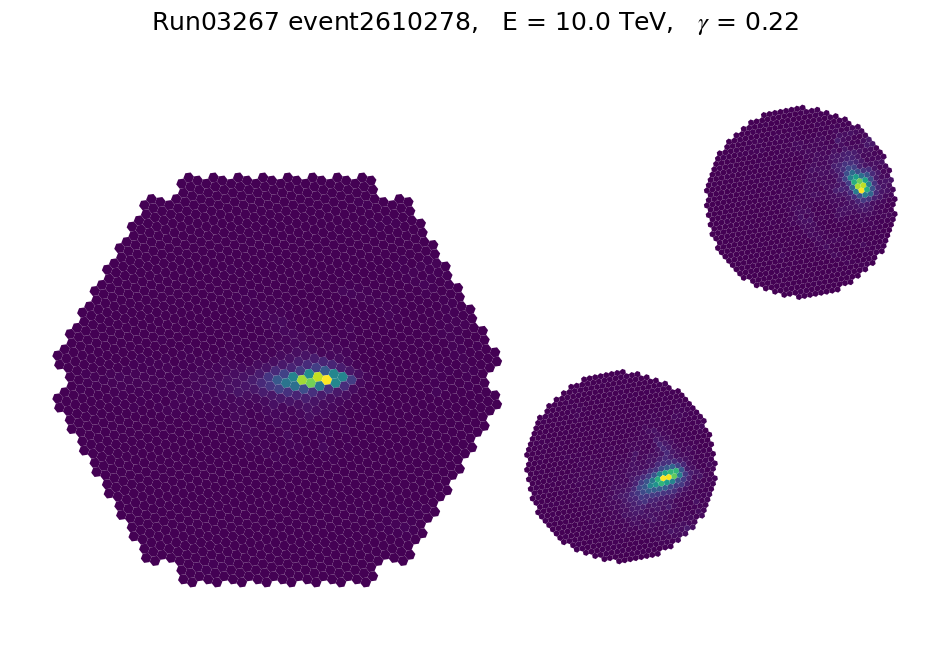

57 of 70


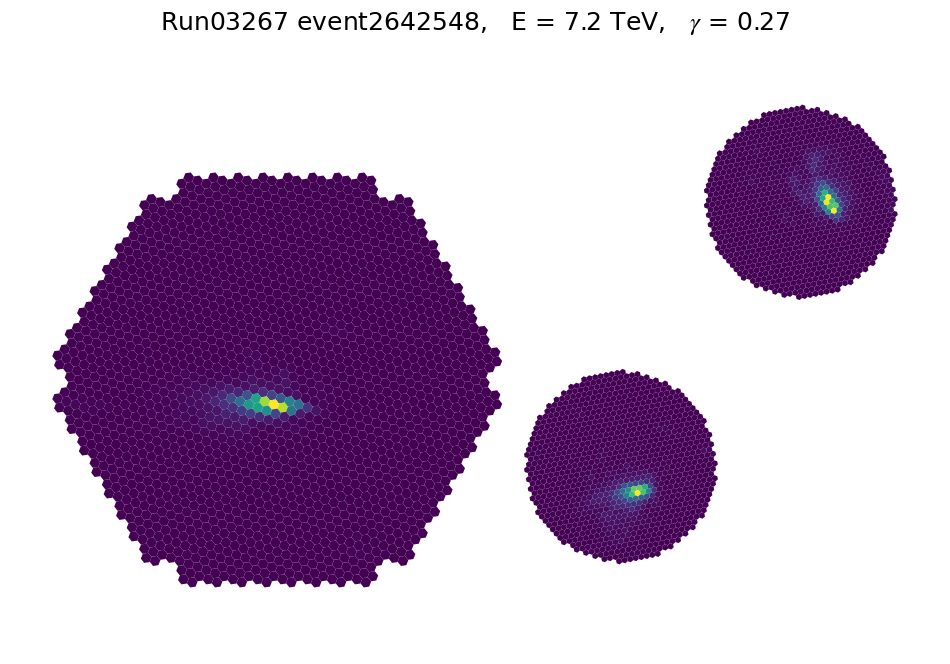

58 of 70


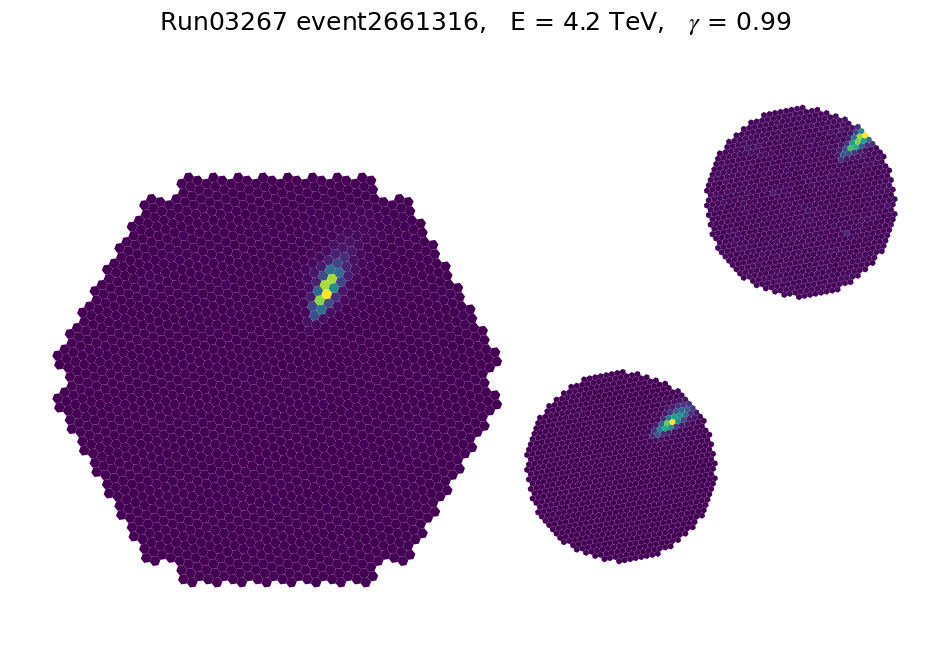

59 of 70


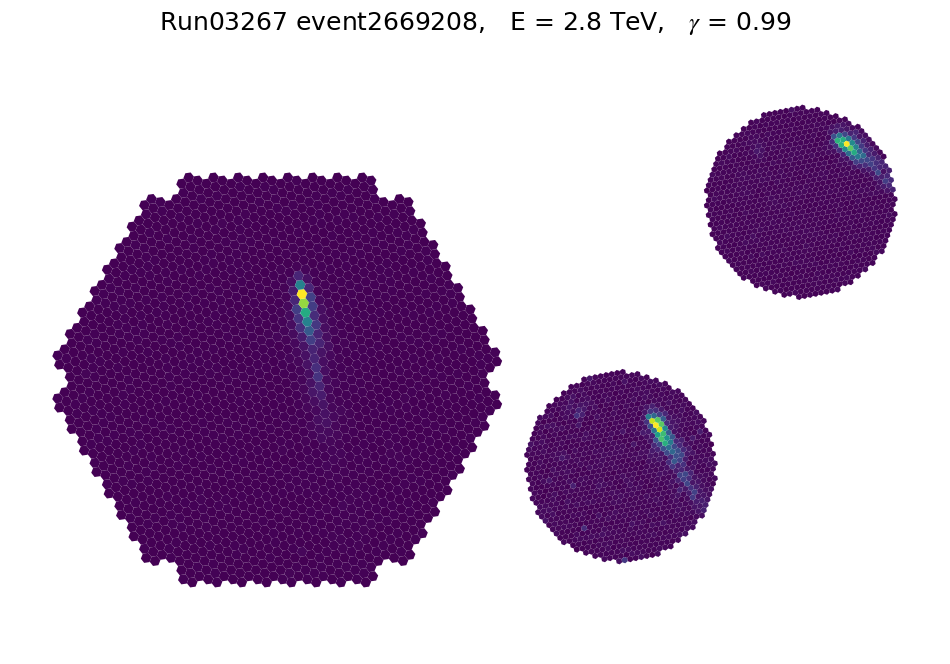

60 of 70


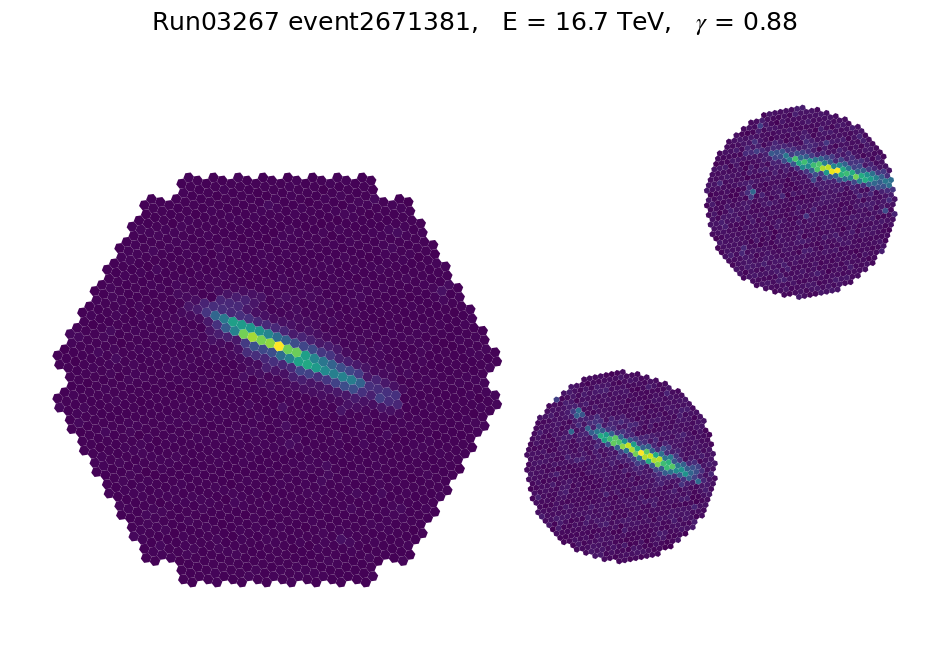

61 of 70


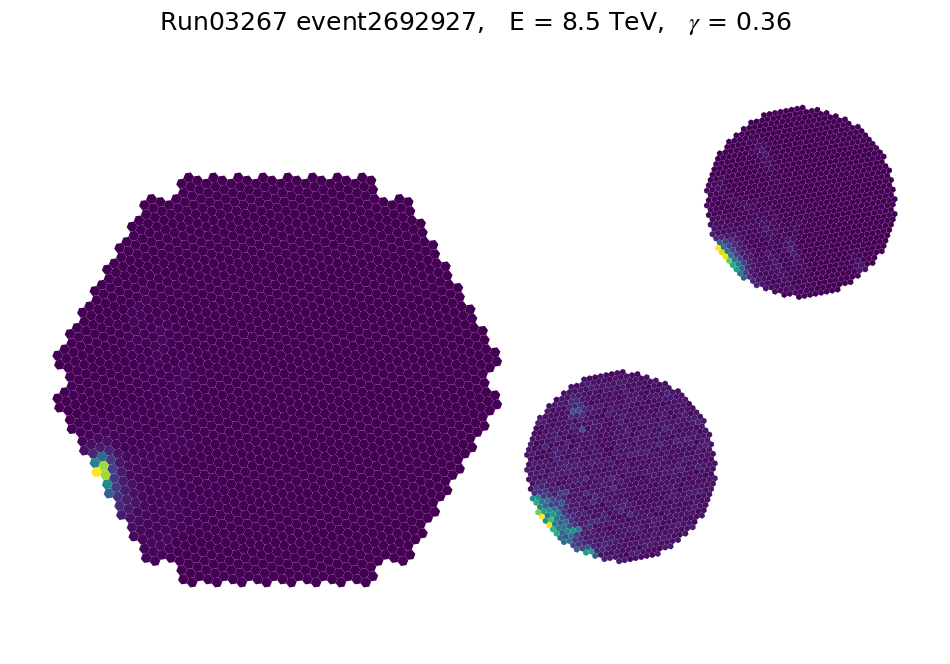

62 of 70


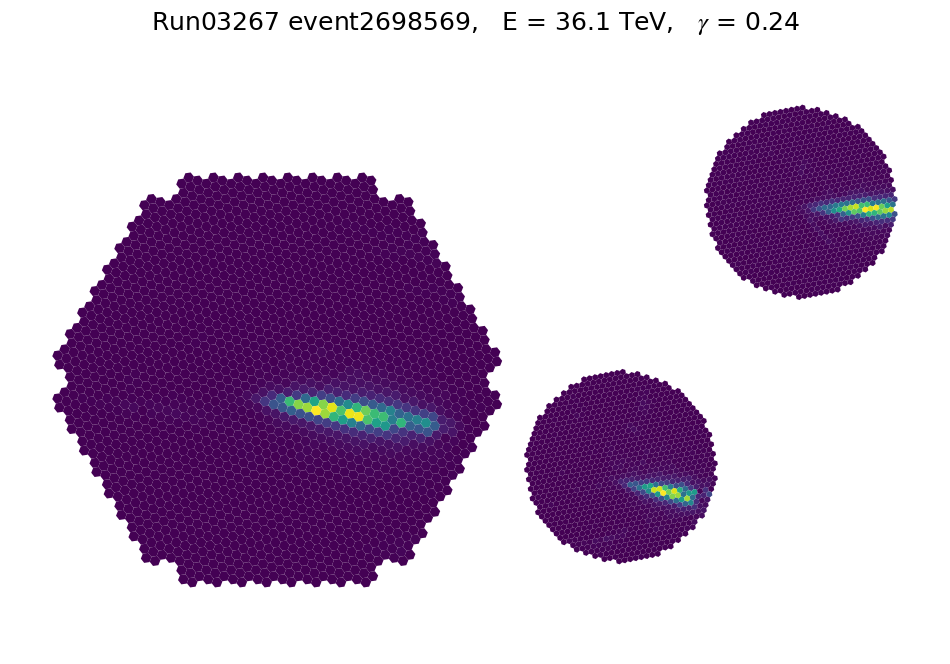

63 of 70


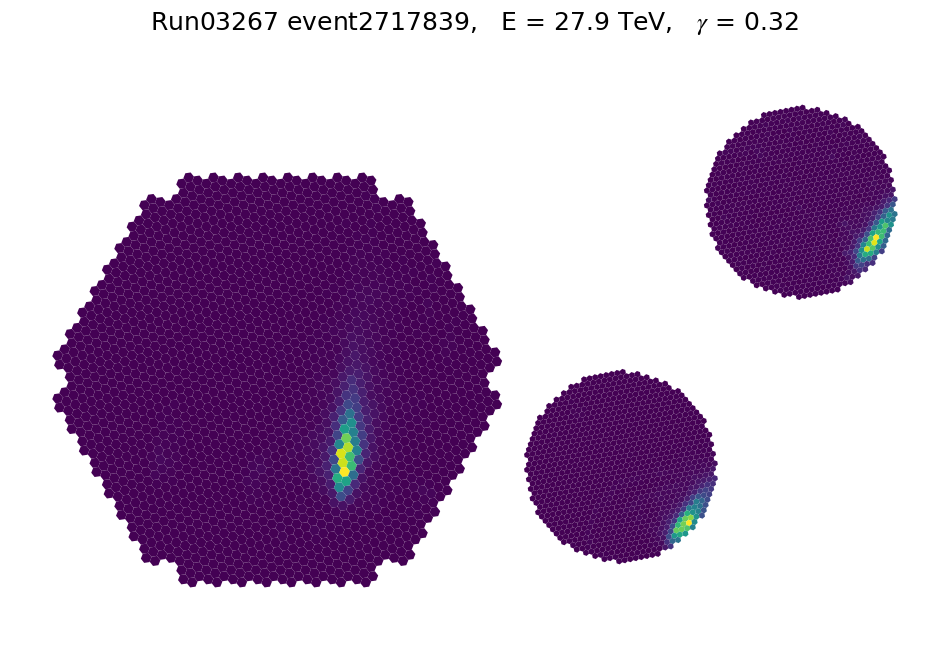

64 of 70


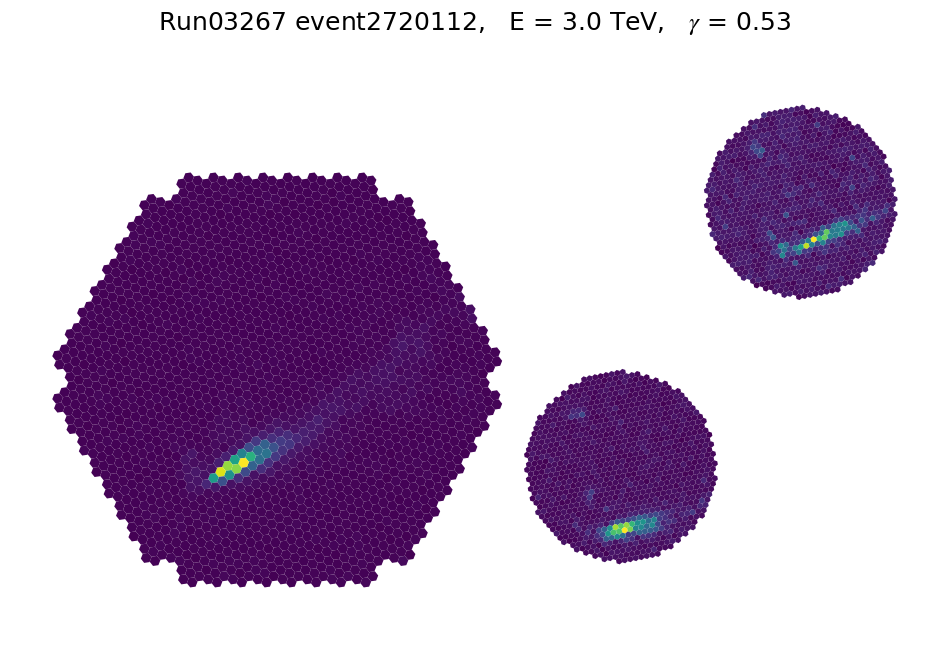

65 of 70


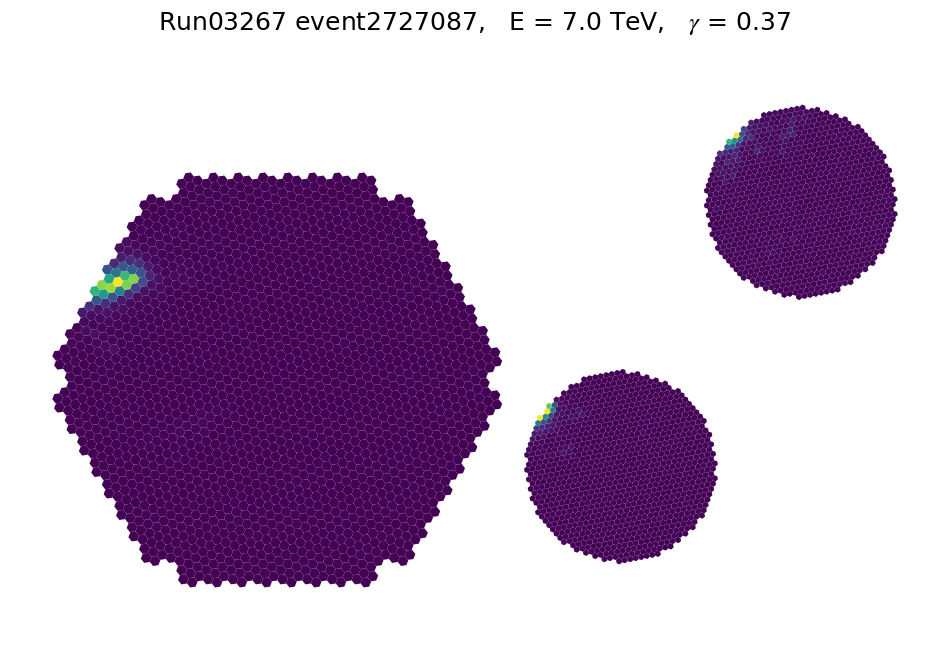

66 of 70


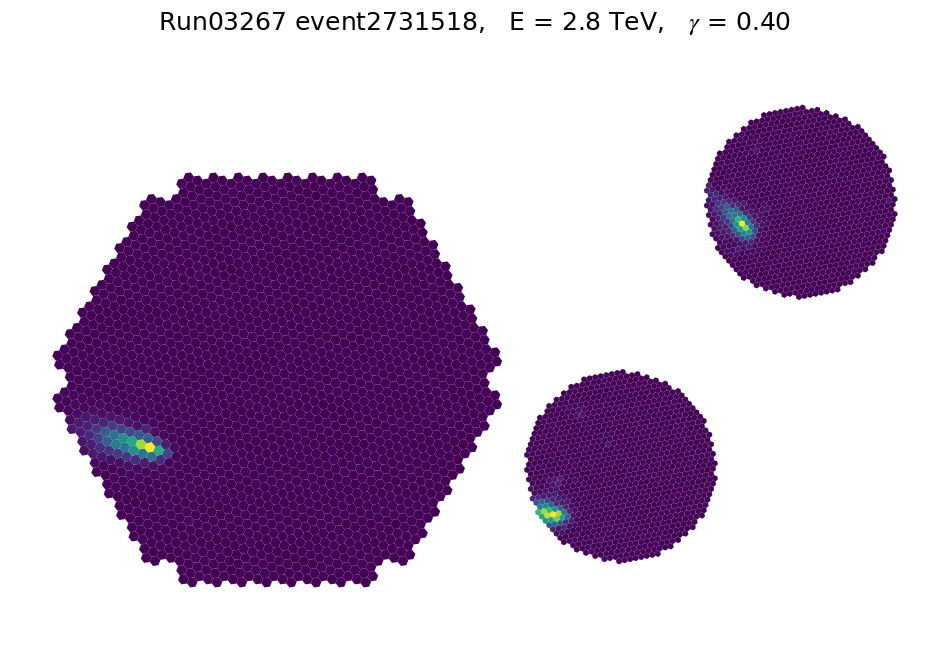

67 of 70


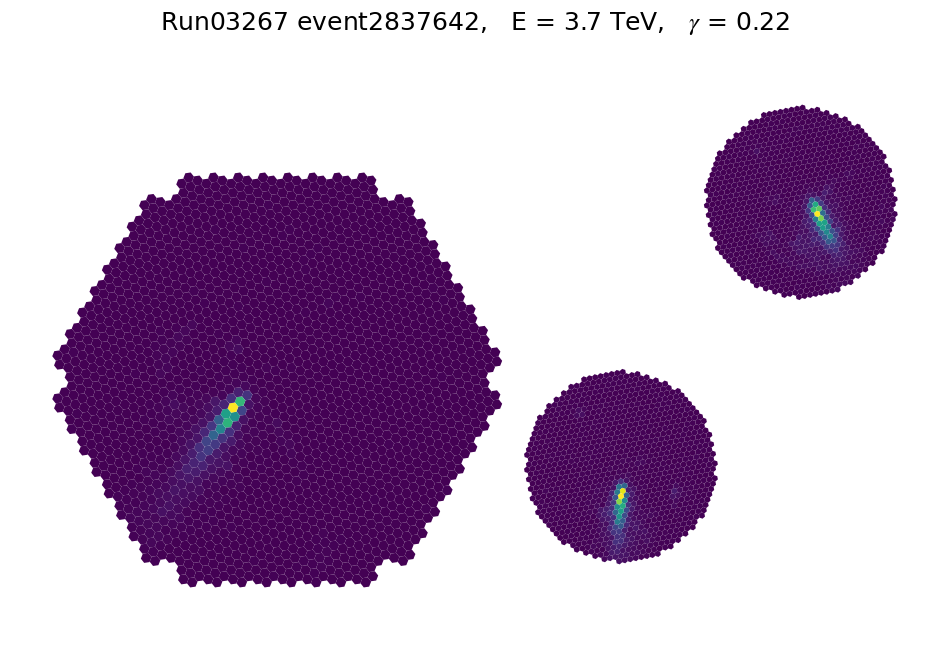

68 of 70


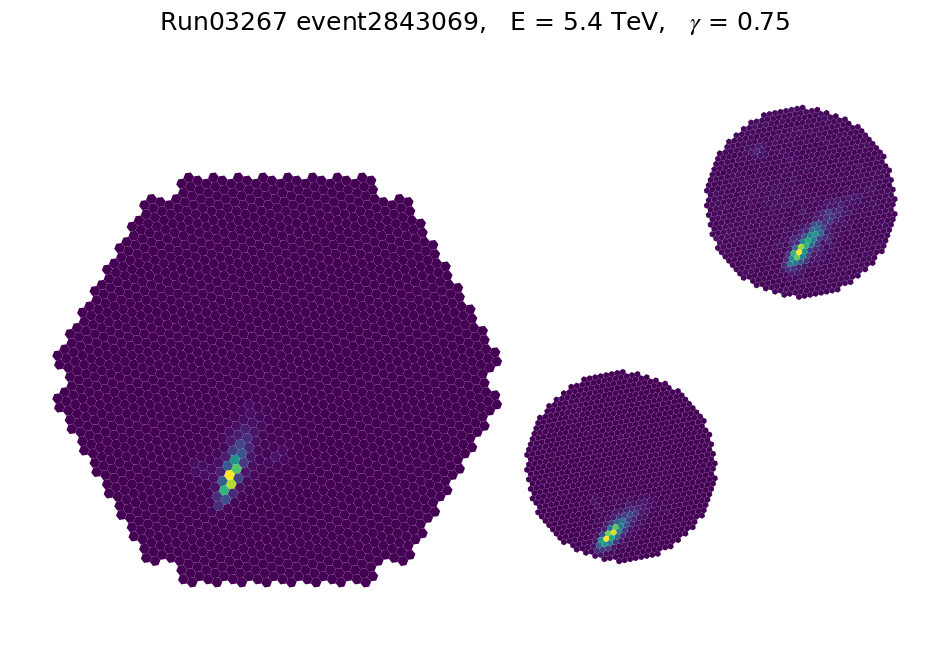

69 of 70


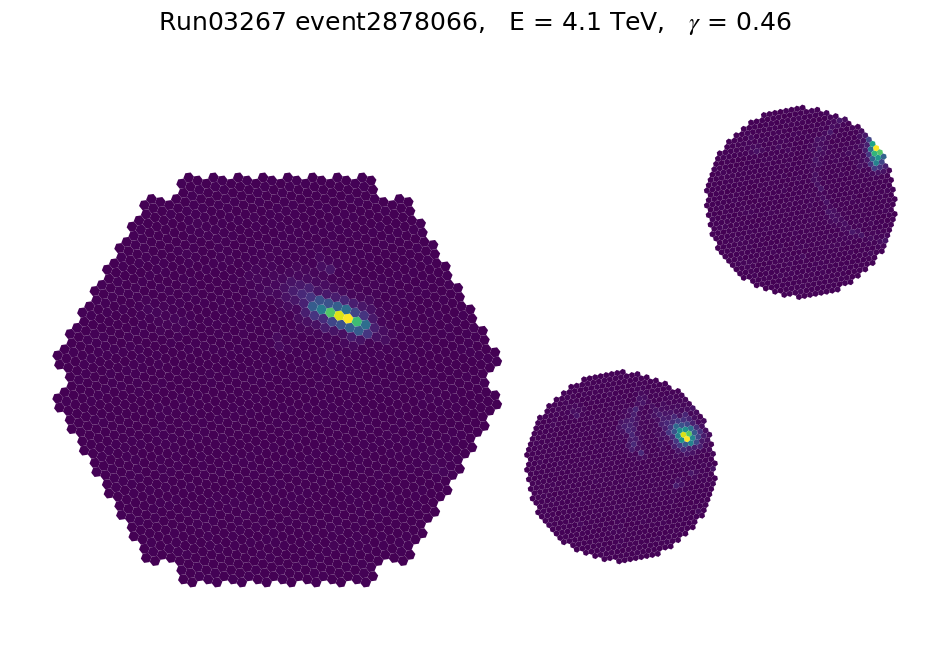

In [11]:
for j in range(len(event_id_l)):

    print(f'{j} of {len(event_id_l)}')
    fig, ax = plt.subplots(figsize=(12, 8))

    disp1 = CameraDisplay(camera_geometry_l, ax=ax, show_frame=False)
    disp2 = CameraDisplay(camera_geometry_m1, ax=ax, show_frame=False)
    disp3 = CameraDisplay(camera_geometry_m2,  ax=ax, show_frame=False)

    # disp1.add_colorbar()
    # disp2.add_colorbar(label="pixel charge")

    disp1.image = image_l[j]
    disp2.image = image_m1[j]
    disp3.image = image_m2[j]

    ax.set_title(f"Run{run_l[i]:05.0f} event{event_id_l[j]},   E = {energ[j]:.1f} TeV,   $\gamma$ = {gamma[j]:.2f}")
    # ax2.set_title('MAGIC-I')
    # ax4.set_title('MAGIC-II')
    # ax3.set_title('LST-1')
    # for ax in [ax1, ax2]:
    # ax.set_xlim(-80, 64)
    # ax.set_ylim(-34, 41)
    # for ax in [ax1, ax2, ax3, ax4]:
    ax.axis('off')


#     plt.savefig(f'{pltpath}Run{run_l[j]:05.0f}.ev{event_id_l[j]}.png', bbox_inches='tight', dpi=dpi)
    plt.show()

## Other geometry

In [12]:
event_source1 = MAGICEventSource(input_url=file_m1[0], process_run=False,)
event_source2 = MAGICEventSource(input_url=file_m2[0], process_run=False,)

subarray1 = event_source1.subarray
subarray2 = event_source2.subarray

camera_geometry_m1 = subarray1.tel[1].camera.geometry
camera_geometry_m2 = subarray2.tel[2].camera.geometry

# reading camera geometries
camera_geometry_l  = CameraGeometry.from_name('LSTCam', version=2)


xm1 = camera_geometry_m1.pix_x
ym1 = camera_geometry_m1.pix_y
xm2 = camera_geometry_m2.pix_x
ym2 = camera_geometry_m2.pix_y

camera_geometry_m1.pix_x, camera_geometry_m1.pix_y = -ym1, -xm1
camera_geometry_m2.pix_x, camera_geometry_m2.pix_y = -ym2, -xm2

camera_geometry_m1.pix_rotation = camera_geometry_m1.pix_rotation*1.96
camera_geometry_m2.pix_rotation = camera_geometry_m2.pix_rotation*1.96

50 of 70


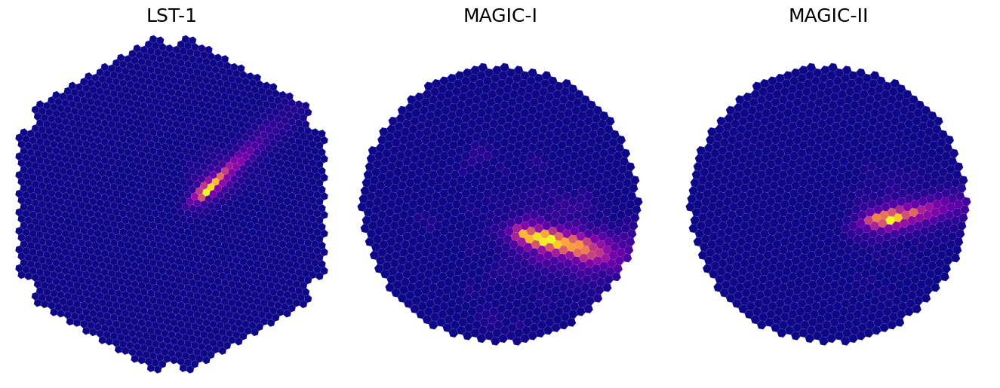

In [26]:
cmap='plasma'

j = 50

print(f'{j} of {len(event_id_l)}')
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(13.5, 5.4))

disp1 = CameraDisplay(camera_geometry_l, ax=ax1, show_frame=False, cmap=cmap)
disp2 = CameraDisplay(camera_geometry_m1, ax=ax2, show_frame=False, cmap=cmap)
disp3 = CameraDisplay(camera_geometry_m2,  ax=ax3, show_frame=False, cmap=cmap)

# disp1.add_colorbar()
# disp2.add_colorbar(label="pixel charge")

disp1.image = image_l[j]
disp2.image = image_m1[j]
disp3.image = image_m2[j]

# disp1.add_ellipse(centroid=(-corey[0][j], -corex[0][j]), width=width[0][j], length=length[0][j], angle=(-angle[0][j]+np.pi/2), color='w')
# disp2.add_ellipse(centroid=(-corey[1][j], -corex[1][j]), width=width[1][j], length=length[1][j], angle=(-angle[1][j]+np.pi/2), color='w')
# disp3.add_ellipse(centroid=(-corey[2][j], -corex[2][j]), width=width[2][j], length=length[2][j], angle=(-angle[2][j]+np.pi/2), color='w')


# ax.set_title(f"Run{run_l[i]:05.0f} event{event_id_l[j]},   E = {energ[j]:.1f} TeV,   $\gamma$ = {gamma[j]:.2f}")
ax2.set_title('MAGIC-I')
ax3.set_title('MAGIC-II')
ax1.set_title('LST-1')


for ax in [ax1, ax2, ax3]:
    ax.axis('off')
fig.tight_layout()
plt.subplots_adjust(wspace=0, hspace=0)



# for i, ax in zip(range(3), [ax1, ax2, ax3]):
# #     slope=np.tan(-df.at[N,'psi']+np.pi/2)
#     xs1, ys1 = geom.line_in_direction(np.rad2deg(-angle[i][j]+np.pi/2), [-corey[i][j],-corex[i][j]], ax1)
#     xs2, ys2 = geom.line_in_direction(np.rad2deg(-angle[i][j]+np.pi/2)+180, [-corey[i][j],-corex[i][j]], ax1)
#     ax1.plot([xs1[1],xs2[1]], [ys1[1],ys2[1]], '-', color='w', lw=1.5, alpha=0.5)
#     if i != 0:
#         ax.plot([xs1[1],xs2[1]], [ys1[1],ys2[1]], '-', color='w', lw=1.5, alpha=0.5)


ax1.set_ylim(-1.25, 1.25)
ax1.set_xlim(-1, 1)
ax2.set_ylim(-0.5, 0.5)
ax2.set_xlim(-0.6, 0.6)
ax3.set_ylim(-0.5, 0.5)
ax3.set_xlim(-0.6, 0.6)
    
    
plt.savefig(f'{pltpath}total-Run{run_l[j]:05.0f}.ev{event_id_l[j]}.png', bbox_inches='tight', dpi=200)

# plt.savefig(f'{pltpath}test.pdf', bbox_inches='tight', dpi=300)
plt.show()

In [14]:
angle[1][14]

1.1523203177170074